In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/brain-tumor-segmentation-in-mri-brats-2015/MICCAI_BraTS_2018_Data_Training/survival_data.csv
/kaggle/input/brain-tumor-segmentation-in-mri-brats-2015/MICCAI_BraTS_2018_Data_Training/HGG/Brats18_CBICA_AXJ_1/Brats18_CBICA_AXJ_1_t2.nii
/kaggle/input/brain-tumor-segmentation-in-mri-brats-2015/MICCAI_BraTS_2018_Data_Training/HGG/Brats18_CBICA_AXJ_1/Brats18_CBICA_AXJ_1_seg.nii
/kaggle/input/brain-tumor-segmentation-in-mri-brats-2015/MICCAI_BraTS_2018_Data_Training/HGG/Brats18_CBICA_AXJ_1/Brats18_CBICA_AXJ_1_t1.nii
/kaggle/input/brain-tumor-segmentation-in-mri-brats-2015/MICCAI_BraTS_2018_Data_Training/HGG/Brats18_CBICA_AXJ_1/Brats18_CBICA_AXJ_1_flair.nii
/kaggle/input/brain-tumor-segmentation-in-mri-brats-2015/MICCAI_BraTS_2018_Data_Training/HGG/Brats18_CBICA_AXJ_1/Brats18_CBICA_AXJ_1_t1ce.nii
/kaggle/input/brain-tumor-segmentation-in-mri-brats-2015/MICCAI_BraTS_2018_Data_Training/HGG/Brats18_2013_3_1/Brats18_2013_3_1_t1.nii
/kaggle/input/brain-tumor-segmentation-in-mri-brats-2

In [2]:
import os
import numpy as np
import nibabel as nib
import random
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from skimage.transform import resize

import tensorflow as tf
from tensorflow.keras import layers, Model
from tensorflow.keras.utils import Sequence
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau

import albumentations as A


SEED = 42
random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)

2025-12-14 15:31:49.458320: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1765726309.658981      37 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1765726309.712025      37 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.8' (you have '2.0.5'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [3]:
TRAIN_DATASET_DIR = "/kaggle/input/brain-tumor-segmentation-in-mri-brats-2015/MICCAI_BraTS2020_TrainingData"


EXCLUDE_PATIENT = "BraTS20_Training_355"


SAVE_DIR = "/kaggle/temp/preprocessed_data"



IMG_HEIGHT, IMG_WIDTH = 128,128
N_CHANNELS = 4    
N_CLASSES  = 4    
BATCH_SIZE = 16
COVERAGE_THRESHOLD = 0.025  # 2.5% for "big tumor" cutoff


os.makedirs(os.path.join(SAVE_DIR, "images"), exist_ok=True)
os.makedirs(os.path.join(SAVE_DIR, "masks"), exist_ok=True)


print("All paths & constants are set.")

All paths & constants are set.


In [4]:
def show_modalities_and_mask(patient_id, dataset_dir, slice_index=100):
    """
    Loads a single slice from each modality (Flair, T1, T1CE, T2) and the mask,
    then displays them side-by-side.
    """
    patient_path = os.path.join(dataset_dir, patient_id)
    
    # Load 3D volumes
    flair_3d = nib.load(os.path.join(patient_path, f"{patient_id}_flair.nii")).get_fdata()
    t1_3d    = nib.load(os.path.join(patient_path, f"{patient_id}_t1.nii")).get_fdata()
    t1ce_3d  = nib.load(os.path.join(patient_path, f"{patient_id}_t1ce.nii")).get_fdata()
    t2_3d    = nib.load(os.path.join(patient_path, f"{patient_id}_t2.nii")).get_fdata()
    seg_3d   = nib.load(os.path.join(patient_path, f"{patient_id}_seg.nii")).get_fdata()
    
    # Convert label 4 -> 3 if needed
    seg_3d[seg_3d == 4] = 3
    

    max_slices = flair_3d.shape[-1]
    if slice_index >= max_slices:
        slice_index = max_slices // 2  # fall back to center slice
    
    
    flair_slice = flair_3d[..., slice_index]
    t1_slice    = t1_3d[..., slice_index]
    t1ce_slice  = t1ce_3d[..., slice_index]
    t2_slice    = t2_3d[..., slice_index]
    mask_slice  = seg_3d[..., slice_index]
    
    
    fig, axes = plt.subplots(1, 5, figsize=(20, 5), dpi=1000)
    axes[0].imshow(flair_slice, cmap='gray')
    axes[0].set_title("Flair")
    axes[0].axis('off')
    
    axes[1].imshow(t1_slice, cmap='gray')
    axes[1].set_title("T1")
    axes[1].axis('off')
    
    axes[2].imshow(t1ce_slice, cmap='gray')
    axes[2].set_title("T1CE")
    axes[2].axis('off')
    
    axes[3].imshow(t2_slice, cmap='gray')
    axes[3].set_title("T2")
    axes[3].axis('off')
    
    axes[4].imshow(mask_slice, cmap='gray')
    axes[4].set_title("Mask")
    axes[4].axis('off')
    
    fig.suptitle(f"Patient: {patient_id} - Slice: {slice_index}", fontsize=14)
    plt.show()


sample_patient_id = "BraTS20_Training_001"
show_modalities_and_mask(sample_patient_id, TRAIN_DATASET_DIR, slice_index=60)

In [5]:
sample_patient_id = "BraTS20_Training_002"
show_modalities_and_mask(sample_patient_id, TRAIN_DATASET_DIR, slice_index=60)

In [6]:
sample_patient_id = "BraTS20_Training_003"
show_modalities_and_mask(sample_patient_id, TRAIN_DATASET_DIR, slice_index=60)

In [7]:
sample_patient_id = "BraTS20_Training_004"
show_modalities_and_mask(sample_patient_id, TRAIN_DATASET_DIR, slice_index=60)

In [8]:
import matplotlib.colors as mcolors

def load_images_and_mask(patient_id, dataset_dir):
    """
    Load the FLAIR image and mask for a given patient.
    """
    patient_path = os.path.join(dataset_dir, patient_id)
    flair_image = nib.load(os.path.join(patient_path, f"{patient_id}_flair.nii")).get_fdata()
    mask = nib.load(os.path.join(patient_path, f"{patient_id}_seg.nii")).get_fdata()
    return flair_image, mask

def map_classes(mask):
    """
    Map class 4 to class 3 in the mask.
    """
    mask[mask == 4] = 3
    return mask

def plot_flair_with_mask(flair_image, mask, slice_index):
    """
    Plot the FLAIR image with each class of the mask overlaid.
    """
    classes = np.unique(mask)
    classes = classes[classes != 0]  # Exclude background class 0
    colors = list(mcolors.TABLEAU_COLORS.values())  # Use Tableau colors for distinct colors

    fig, axes = plt.subplots(1, len(classes) + 1, figsize=(20, 5),dpi= 1000)

    
    axes[0].imshow(flair_image[:, :, slice_index], cmap='gray')
    for i, cls in enumerate(classes):
        masked_image = np.ma.masked_where(mask != cls, mask)
        axes[0].imshow(masked_image[:, :, slice_index], cmap=mcolors.ListedColormap([colors[i]]), alpha=1)
    axes[0].set_title("All Classes Overlay")
    axes[0].axis('off')

    
    for i, cls in enumerate(classes):
        masked_image = np.ma.masked_where(mask != cls, mask)
        axes[i + 1].imshow(flair_image[:, :, slice_index], cmap='gray')
        axes[i + 1].imshow(masked_image[:, :, slice_index], cmap=mcolors.ListedColormap([colors[i]]), alpha=1)
        axes[i + 1].set_title(f"Class {int(cls)} Overlay")
        axes[i + 1].axis('off')

    plt.tight_layout()
    plt.show()




In [9]:
patient_id = "BraTS20_Training_001"
dataset_dir = TRAIN_DATASET_DIR
slice_index = 60


flair_image, mask = load_images_and_mask(patient_id, dataset_dir)


mask = map_classes(mask)


plot_flair_with_mask(flair_image, mask, slice_index)

In [10]:
patient_id = "BraTS20_Training_002"
dataset_dir = TRAIN_DATASET_DIR
slice_index = 60


flair_image, mask = load_images_and_mask(patient_id, dataset_dir)


mask = map_classes(mask)


plot_flair_with_mask(flair_image, mask, slice_index)

In [11]:
patient_id = "BraTS20_Training_001"
dataset_dir = TRAIN_DATASET_DIR
slice_index = 61


flair_image, mask = load_images_and_mask(patient_id, dataset_dir)


mask = map_classes(mask)


plot_flair_with_mask(flair_image, mask, slice_index)

In [12]:
from skimage.util import montage
from scipy.ndimage import rotate


def visualize_coronal_montage(patient_id, dataset_dir, modality="flair", cmap="gray"):
    """
    Visualizes a montage of coronal slices (top view) for a given patient's 3D modality.

    Args:
        patient_id (str): Patient ID (e.g., "BraTS20_Training_001").
        dataset_dir (str): Path to the dataset directory.
        modality (str): Modality to visualize ("flair", "t1", "t1ce", "t2").
        cmap (str): Colormap for the visualization (default is "gray").
    """
    
    file_path = os.path.join(dataset_dir, patient_id, f"{patient_id}_{modality}.nii")
    
    
    if not os.path.exists(file_path):
        print(f"File not found: {file_path}")
        return
    volume_3d = nib.load(file_path).get_fdata()
    
    
    coronal_slices = volume_3d.transpose(1, 0, 2)  
    
    
    coronal_montage = montage(coronal_slices)
    
    
    coronal_montage_rotated = rotate(coronal_montage, angle=90)
    
    
    plt.figure(figsize=(20, 20))
    plt.imshow(coronal_montage_rotated, cmap=cmap)
    plt.title(f"{modality.upper()} - Coronal Montage (Top View) for Patient {patient_id}", fontsize=16)
    plt.axis('off')
    plt.show()



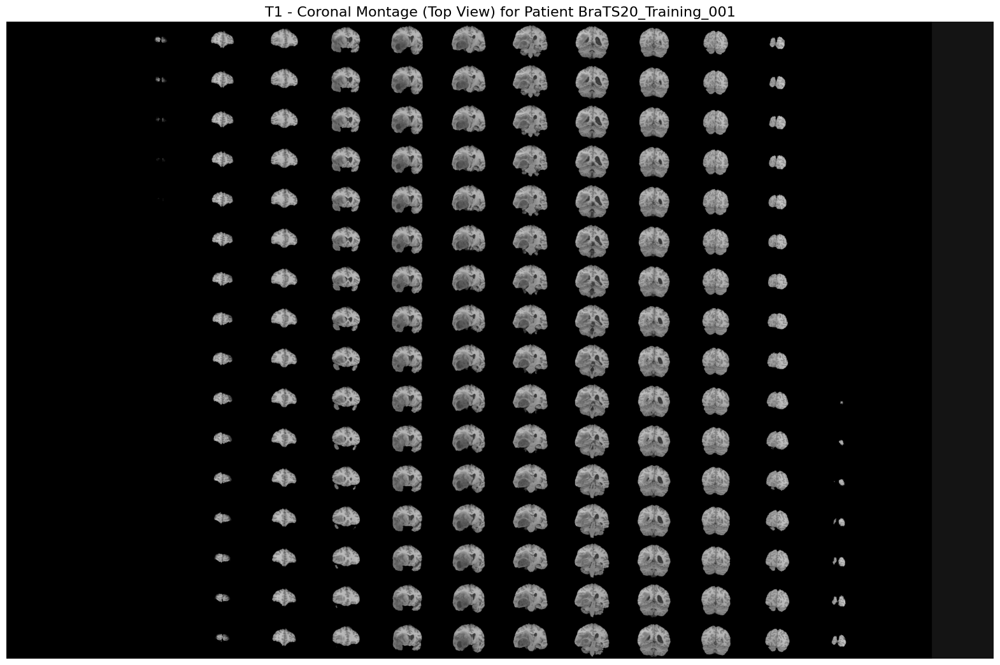

In [13]:
sample_patient_id = "BraTS20_Training_001"
visualize_coronal_montage(sample_patient_id, TRAIN_DATASET_DIR, modality="t1", cmap="gray")


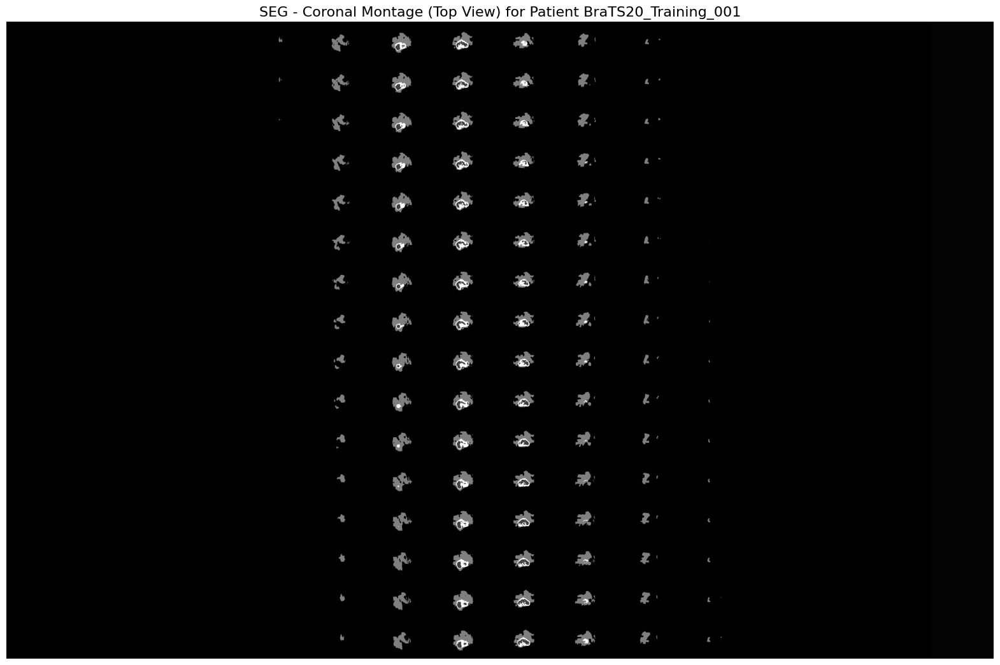

In [14]:
visualize_coronal_montage(sample_patient_id, TRAIN_DATASET_DIR, modality="seg", cmap="gray")

In [15]:
def count_black_slices(patient_id, dataset_dir):
    """
    Counts the number of black slices (slices without any tumor data)
    for the given patient's segmentation mask.

    Args:
        patient_id (str): Patient ID (e.g., "BraTS20_Training_001").
        dataset_dir (str): Path to the dataset directory.

    Returns:
        int: Number of black slices.
        int: Total number of slices.
    """
    
    seg_path = os.path.join(dataset_dir, patient_id, f"{patient_id}_seg.nii")
    
    if not os.path.exists(seg_path):
        print(f"Segmentation file not found: {seg_path}")
        return 0, 0
    
    
    seg_3d = nib.load(seg_path).get_fdata()
    
    
    seg_3d[seg_3d == 4] = 3
    
    
    total_slices = seg_3d.shape[-1]
    black_slices = 0
    
    for z in range(total_slices):
        slice_2d = seg_3d[..., z]
        if np.count_nonzero(slice_2d) == 0:  
            black_slices += 1
    
    return black_slices, total_slices


sample_patient_id = "BraTS20_Training_001"
black_slices, total_slices = count_black_slices(sample_patient_id, TRAIN_DATASET_DIR)

print(f"Patient: {sample_patient_id}")
print(f"Black slices (no tumor data): {black_slices}")
print(f"Total slices: {total_slices}")
print(f"Percentage of black slices: {black_slices / total_slices * 100:.2f}%")

Patient: BraTS20_Training_001
Black slices (no tumor data): 72
Total slices: 155
Percentage of black slices: 46.45%


In [16]:
def calculate_black_slices_stats(dataset_dir, patient_ids):
    """
    Calculates black slice statistics (slices without tumor data) across the dataset.

    Args:
        dataset_dir (str): Path to the dataset directory.
        patient_ids (list): List of patient IDs in the dataset.

    Returns:
        dict: A dictionary containing patient stats:
              {patient_id: {"black_slices": int, "total_slices": int, "percentage": float}}
        int: Total number of black slices across the dataset.
        int: Total number of slices across the dataset.
    """
    stats = {}
    total_black_slices = 0
    total_slices = 0

    for patient_id in patient_ids:
        seg_path = os.path.join(dataset_dir, patient_id, f"{patient_id}_seg.nii")
        
        if not os.path.exists(seg_path):
            print(f"Segmentation file not found: {seg_path}, skipping patient {patient_id}.")
            continue
        
        # Load the segmentation mask
        seg_3d = nib.load(seg_path).get_fdata()
        seg_3d[seg_3d == 4] = 3  

        
        black_slices = 0
        for z in range(seg_3d.shape[-1]):
            if np.count_nonzero(seg_3d[..., z]) == 0:
                black_slices += 1
        
        total_slices += seg_3d.shape[-1]
        total_black_slices += black_slices
        
        stats[patient_id] = {
            "black_slices": black_slices,
            "total_slices": seg_3d.shape[-1],
            "percentage": (black_slices / seg_3d.shape[-1]) * 100
        }
    
    return stats, total_black_slices, total_slices


all_patient_ids = [d for d in os.listdir(TRAIN_DATASET_DIR) 
                   if d.startswith("BraTS20_Training_") 
                   and os.path.isdir(os.path.join(TRAIN_DATASET_DIR, d))]

stats, total_black_slices, total_slices = calculate_black_slices_stats(TRAIN_DATASET_DIR, all_patient_ids)

print(f"Total black slices across the dataset: {total_black_slices}")
print(f"Total slices across the dataset: {total_slices}")
print(f"Percentage of black slices: {total_black_slices / total_slices * 100:.2f}%")

Segmentation file not found: /kaggle/input/brain-tumor-segmentation-in-mri-brats-2015/MICCAI_BraTS2020_TrainingData/BraTS20_Training_355/BraTS20_Training_355_seg.nii, skipping patient BraTS20_Training_355.
Total black slices across the dataset: 32686
Total slices across the dataset: 57040
Percentage of black slices: 57.30%


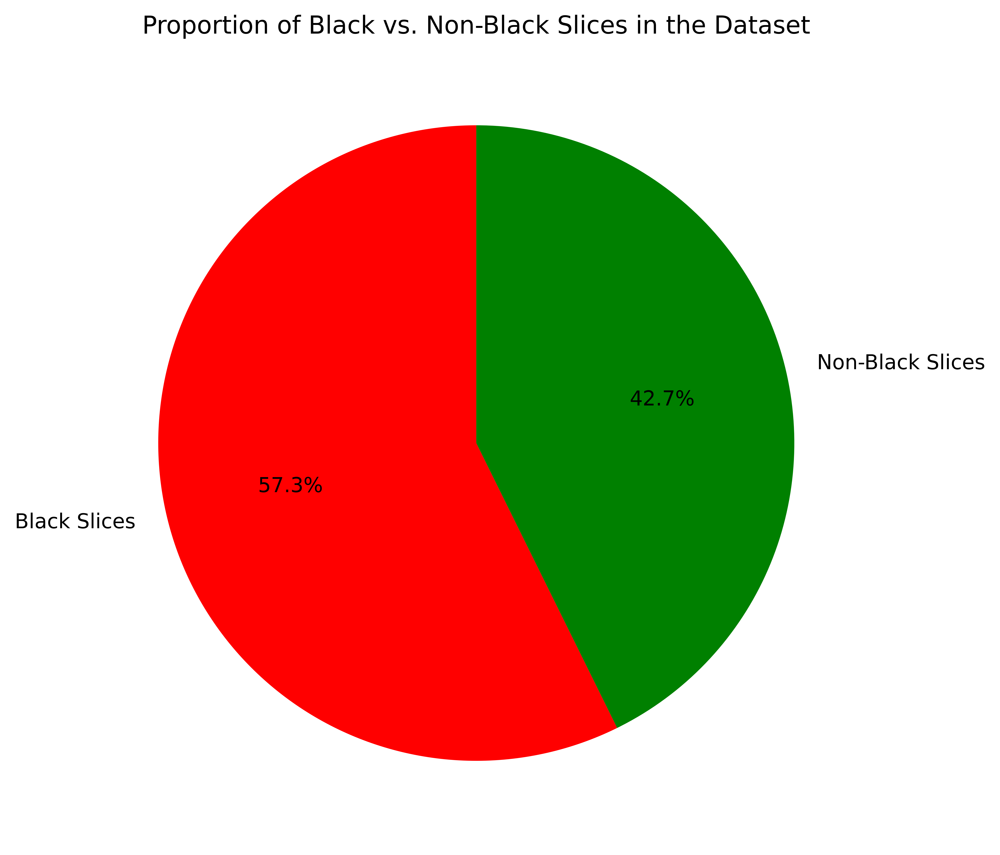

In [17]:
non_black_slices = total_slices - total_black_slices
labels = ["Black Slices", "Non-Black Slices"]
sizes = [total_black_slices, non_black_slices]


plt.figure(figsize=(7, 7),dpi=1000)
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90, colors=['red', 'green'])
plt.title("Proportion of Black vs. Non-Black Slices in the Dataset")
plt.show()

Total Slices are:  57040


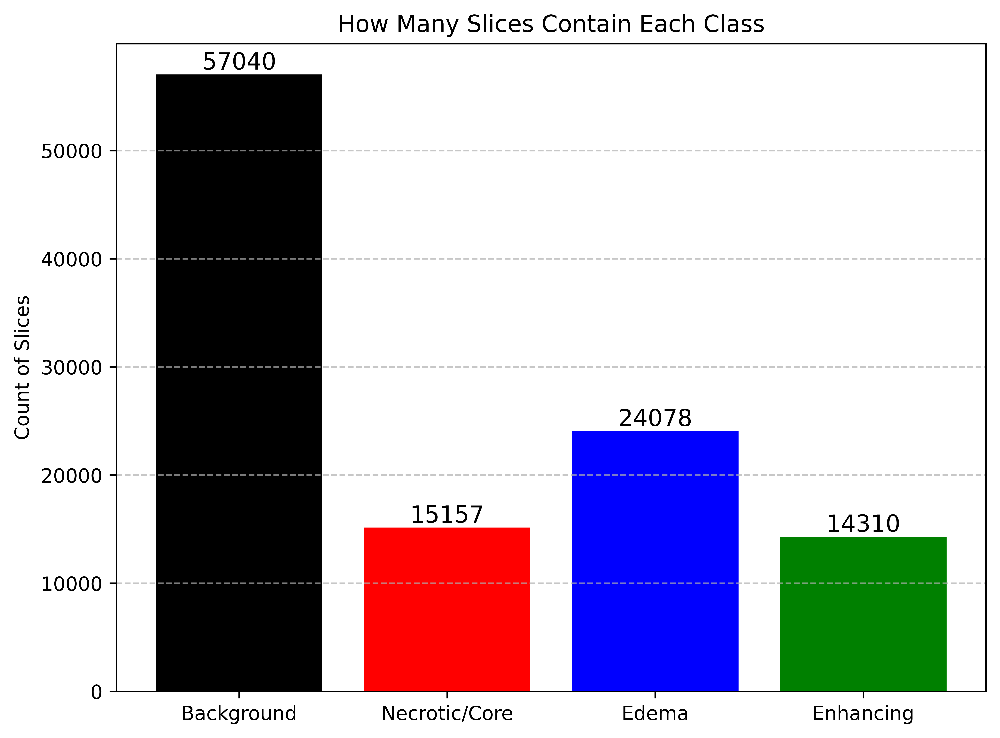

In [18]:
def compute_slice_class_coverage(dataset_dir, patient_ids, n_classes=4):
    """
    Returns how many slices contain each class at least once.
    """
    coverage_counts = np.zeros(n_classes, dtype=np.int64)
    
    for i, pid in enumerate(patient_ids, start=1):
        seg_path = os.path.join(dataset_dir, pid, f"{pid}_seg.nii")
        if not os.path.exists(seg_path):
            continue
        
        seg_data = nib.load(seg_path).get_fdata()
        seg_data[seg_data == 4] = 3
        
        
        depth = seg_data.shape[-1]
        for z in range(depth):
            slice_2d = seg_data[..., z]
            
            unique_vals = np.unique(slice_2d)
            for c in unique_vals:
                if c < n_classes:  
                    coverage_counts[int(c)] += 1
        
    
    return coverage_counts

slice_coverage = compute_slice_class_coverage(TRAIN_DATASET_DIR, all_patient_ids, n_classes=4)

print("Total Slices are: ",(368*155))



labels = ['Background', 'Necrotic/Core', 'Edema', 'Enhancing']



plt.figure(figsize=(8, 6),dpi=1000)
bars = plt.bar(labels, slice_coverage, color=['black', 'red', 'blue', 'green'])


plt.title("How Many Slices Contain Each Class")
plt.ylabel("Count of Slices")


plt.grid(axis='y', linestyle='--', alpha=0.7)


for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height, f'{int(height)}', 
             ha='center', va='bottom', fontsize=12, color='black')


plt.show()

Overall pixel distribution ('Background','Necrotic/Core','Edema','Enhancing'):
 [3248909300    8129761   21256835    7208104]


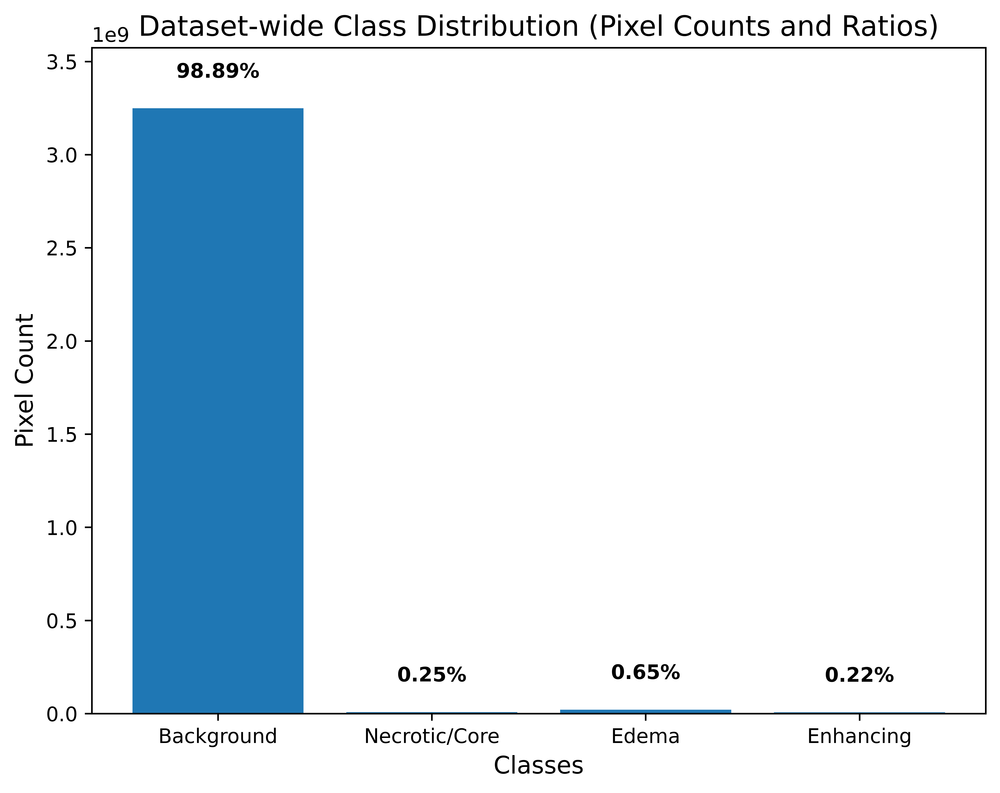

In [19]:
def compute_class_distribution_3d(dataset_dir, patient_ids, n_classes=4):
    
    total_counts = np.zeros(n_classes, dtype=np.int64)
    
    for i, pid in enumerate(patient_ids, start=1):
        seg_path = os.path.join(dataset_dir, pid, f"{pid}_seg.nii")
        if not os.path.exists(seg_path):
            
            continue
        
        seg_data = nib.load(seg_path).get_fdata()
        seg_data[seg_data == 4] = 3  

        
        for c in range(n_classes):
            total_counts[c] += np.count_nonzero(seg_data == c)
    
    return total_counts


labels = ['Background', 'Necrotic/Core', 'Edema', 'Enhancing']
all_patients = [d for d in os.listdir(TRAIN_DATASET_DIR)
                if d.startswith("BraTS20_Training_") 
                and os.path.isdir(os.path.join(TRAIN_DATASET_DIR, d))]

class_counts = compute_class_distribution_3d(TRAIN_DATASET_DIR, all_patients, n_classes=4)

print("Overall pixel distribution ('Background','Necrotic/Core','Edema','Enhancing'):\n", class_counts)


import matplotlib.pyplot as plt


total_pixels = np.sum(class_counts)  
ratios = class_counts / total_pixels  


plt.figure(figsize=(8, 6),dpi=1000)
bars = plt.bar(labels, class_counts )


for bar, ratio in zip(bars, ratios):
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        height + 0.05 * total_pixels,
        f"{ratio * 100:.2f}%",  
        ha='center',
        fontsize=10,
        fontweight='bold'
    )
plt.title("Dataset-wide Class Distribution (Pixel Counts and Ratios)", fontsize=14)
plt.ylabel("Pixel Count", fontsize=12)
plt.xlabel("Classes", fontsize=12)
plt.ylim(0, max(class_counts) * 1.1) 

plt.show()

In [20]:
import os
import numpy as np
import nibabel as nib
import matplotlib.pyplot as plt

def load_images(patient_id, dataset_dir):
    
    patient_path = os.path.join(dataset_dir, patient_id)
    modalities = ['flair', 't1', 't1ce', 't2']
    images = {}
    for modality in modalities:
        image_path = os.path.join(patient_path, f"{patient_id}_{modality}.nii")
        images[modality] = nib.load(image_path).get_fdata()
    return images

def z_score_normalization(image):
    
    mean = np.mean(image)
    std = np.std(image)
    return (image - mean) / std

def plot_histograms(images, normalized_images):
    
    fig, axes = plt.subplots(2, 4, figsize=(20, 10),dpi=1000)

    modalities = ['flair', 't1', 't1ce', 't2']
    for i, modality in enumerate(modalities):
        axes[0, i].hist(images[modality].flatten(), bins=50, color='blue', alpha=0.7)
        axes[0, i].set_title(f"Raw {modality.upper()} Histogram")
        axes[0, i].set_xlabel("Pixel Intensity")
        axes[0, i].set_ylabel("Frequency")

        axes[1, i].hist(normalized_images[modality].flatten(), bins=50, color='green', alpha=0.7)
        axes[1, i].set_title(f"Z-Score Normalized {modality.upper()} Histogram")
        axes[1, i].set_xlabel("Pixel Intensity")
        axes[1, i].set_ylabel("Frequency")

    plt.tight_layout()
    plt.show()


patient_id = "BraTS20_Training_001"
 


raw_images = load_images(patient_id, TRAIN_DATASET_DIR)


normalized_images = {modality: z_score_normalization(image) for modality, image in raw_images.items()}


plot_histograms(raw_images, normalized_images)

In [21]:
def z_score_normalize(slice_2d, epsilon=1e-8):
    mean_val = np.mean(slice_2d)
    std_val  = np.std(slice_2d)
    return (slice_2d - mean_val) / (std_val + epsilon)

def crop_to_brain_with_mask(flair_2d, t1_2d, t1ce_2d, t2_2d,
                            seg_2d, margin=5, out_size=(240,240)):
    
    combined = (np.abs(flair_2d) + np.abs(t1_2d)
                + np.abs(t1ce_2d) + np.abs(t2_2d))
    coords = np.where(combined > 1e-5)
    if len(coords[0]) == 0:
       
        final_img = np.stack([
            resize(z_score_normalize(flair_2d), out_size, preserve_range=True),
            resize(z_score_normalize(t1_2d),    out_size, preserve_range=True),
            resize(z_score_normalize(t1ce_2d),  out_size, preserve_range=True),
            resize(z_score_normalize(t2_2d),    out_size, preserve_range=True),
        ], axis=-1)
        final_mask = resize(seg_2d, out_size, preserve_range=True, order=0).astype(np.int32)
        return final_img, final_mask

    min_r, max_r = np.min(coords[0]), np.max(coords[0])
    min_c, max_c = np.min(coords[1]), np.max(coords[1])
    min_r = max(0, min_r - margin)
    min_c = max(0, min_c - margin)
    max_r = min(flair_2d.shape[0], max_r + margin)
    max_c = min(flair_2d.shape[1], max_c + margin)

    flair_crop = flair_2d[min_r:max_r, min_c:max_c]
    t1_crop    = t1_2d[min_r:max_r,   min_c:max_c]
    t1ce_crop  = t1ce_2d[min_r:max_r, min_c:max_c]
    t2_crop    = t2_2d[min_r:max_r,   min_c:max_c]
    seg_crop   = seg_2d[min_r:max_r,  min_c:max_c]

    
    flair_z = z_score_normalize(flair_crop)
    t1_z    = z_score_normalize(t1_crop)
    t1ce_z  = z_score_normalize(t1ce_crop)
    t2_z    = z_score_normalize(t2_crop)

    final_img = np.zeros((*out_size, 4), dtype=np.float32)
    for i, ch_data in enumerate([flair_z, t1_z, t1ce_z, t2_z]):
        final_img[..., i] = resize(ch_data, out_size, preserve_range=True)
    final_mask = resize(seg_crop, out_size, preserve_range=True, order=0).astype(np.int32)

    return final_img, final_mask

In [22]:
def preprocess_patient(
    patient_id,
    dataset_dir,
    save_dir,
    margin=2,
    out_size=(240,240),
    big_tumor_thresh=COVERAGE_THRESHOLD  # 2.5% threshold
):
    
    patient_path = os.path.join(dataset_dir, patient_id)
    flair_data = nib.load(os.path.join(patient_path, f"{patient_id}_flair.nii")).get_fdata()
    t1_data    = nib.load(os.path.join(patient_path, f"{patient_id}_t1.nii")).get_fdata()
    t1ce_data  = nib.load(os.path.join(patient_path, f"{patient_id}_t1ce.nii")).get_fdata()
    t2_data    = nib.load(os.path.join(patient_path, f"{patient_id}_t2.nii")).get_fdata()
    seg_data   = nib.load(os.path.join(patient_path, f"{patient_id}_seg.nii")).get_fdata()

    seg_data[seg_data == 4] = 3

    images_dir = os.path.join(save_dir, "images")
    masks_dir  = os.path.join(save_dir, "masks")
    os.makedirs(images_dir, exist_ok=True)
    os.makedirs(masks_dir, exist_ok=True)

    big_slices   = []
    small_slices = []
    no_tumor_temp= []

    depth = flair_data.shape[2]
    for z in range(depth):
        flair_slice = flair_data[..., z]
        t1_slice    = t1_data[..., z]
        t1ce_slice  = t1ce_data[..., z]
        t2_slice    = t2_data[..., z]
        seg_slice   = seg_data[..., z].astype(np.int32)

        final_img, final_mask = crop_to_brain_with_mask(
            flair_slice, t1_slice, t1ce_slice, t2_slice,
            seg_slice,
            margin=margin,
            out_size=out_size
        )

        
        H, W = final_mask.shape
        mask_1hot = np.eye(4)[final_mask.reshape(-1)].reshape(H, W, 4)

        label_2d = np.argmax(mask_1hot, axis=-1)
        tumor_px  = np.count_nonzero(label_2d > 0)
        coverage  = tumor_px / float(label_2d.size)

        slice_fname = f"{patient_id}_slice{z}.npy"

        if coverage == 0.0:
            
            no_tumor_temp.append((slice_fname, final_img, mask_1hot))
        else:
            if coverage >= big_tumor_thresh:
                big_slices.append(slice_fname)
            else:
                small_slices.append(slice_fname)

            
            np.save(os.path.join(images_dir, slice_fname), final_img.astype(np.float32))
            np.save(os.path.join(masks_dir,  slice_fname), mask_1hot.astype(np.float32))

    
    random.shuffle(no_tumor_temp)
    no_tumor_temp = no_tumor_temp[:3]
    for fname, im_data, mk_data in no_tumor_temp:
        small_slices.append(fname)
        np.save(os.path.join(images_dir, fname), im_data.astype(np.float32))
        np.save(os.path.join(masks_dir, fname), mk_data.astype(np.float32))

    return big_slices, small_slices

In [23]:
def compare_original_vs_preprocessed(patient_id, dataset_dir, save_dir, slice_index=100):
    
    patient_path = os.path.join(dataset_dir, patient_id)
    flair_original = nib.load(os.path.join(patient_path, f"{patient_id}_flair.nii")).get_fdata()
    t1_original = nib.load(os.path.join(patient_path, f"{patient_id}_t1.nii")).get_fdata()
    t1ce_original = nib.load(os.path.join(patient_path, f"{patient_id}_t1ce.nii")).get_fdata()
    t2_original = nib.load(os.path.join(patient_path, f"{patient_id}_t2.nii")).get_fdata()
    seg_original = nib.load(os.path.join(patient_path, f"{patient_id}_seg.nii")).get_fdata()
    seg_original[seg_original == 4] = 3  

    # Load preprocessed images
    preprocessed_image_path = os.path.join(save_dir, "images", f"{patient_id}_slice{slice_index}.npy")
    preprocessed_mask_path = os.path.join(save_dir, "masks", f"{patient_id}_slice{slice_index}.npy")
    if not os.path.exists(preprocessed_image_path) or not os.path.exists(preprocessed_mask_path):
        print(f"Preprocessed slice {slice_index} not found for patient {patient_id}.")
        return

    preprocessed_image = np.load(preprocessed_image_path)
    preprocessed_mask = np.argmax(np.load(preprocessed_mask_path), axis=-1) 

    
    fig, axes = plt.subplots(2, 5, figsize=(20, 8), dpi=1000)

    
    axes[0, 0].imshow(flair_original[..., slice_index], cmap="gray")
    axes[0, 0].set_title("Original Flair")
    axes[0, 0].axis("off")

    axes[0, 1].imshow(t1_original[..., slice_index], cmap="gray")
    axes[0, 1].set_title("Original T1")
    axes[0, 1].axis("off")

    axes[0, 2].imshow(t1ce_original[..., slice_index], cmap="gray")
    axes[0, 2].set_title("Original T1CE")
    axes[0, 2].axis("off")

    axes[0, 3].imshow(t2_original[..., slice_index], cmap="gray")
    axes[0, 3].set_title("Original T2")
    axes[0, 3].axis("off")

    axes[0, 4].imshow(seg_original[..., slice_index], cmap="jet")
    axes[0, 4].set_title("Original Mask")
    axes[0, 4].axis("off")

   
    axes[1, 0].imshow(preprocessed_image[..., 0], cmap="gray")
    axes[1, 0].set_title("Preprocessed Flair")
    axes[1, 0].axis("off")

    axes[1, 1].imshow(preprocessed_image[..., 1], cmap="gray")
    axes[1, 1].set_title("Preprocessed T1")
    axes[1, 1].axis("off")

    axes[1, 2].imshow(preprocessed_image[..., 2], cmap="gray")
    axes[1, 2].set_title("Preprocessed T1CE")
    axes[1, 2].axis("off")

    axes[1, 3].imshow(preprocessed_image[..., 3], cmap="gray")
    axes[1, 3].set_title("Preprocessed T2")
    axes[1, 3].axis("off")

    axes[1, 4].imshow(preprocessed_mask, cmap="jet")
    axes[1, 4].set_title("Preprocessed Mask")
    axes[1, 4].axis("off")

    plt.suptitle(f"Comparison of Original vs. Preprocessed Slices (Patient {patient_id}, Slice {slice_index})")
    plt.tight_layout()
    plt.show()

patient_id = "BraTS20_Training_001"
preprocess_patient(
    patient_id=patient_id,
    dataset_dir=TRAIN_DATASET_DIR,
    save_dir=SAVE_DIR
)


compare_original_vs_preprocessed(
    patient_id=patient_id,
    dataset_dir=TRAIN_DATASET_DIR,
    save_dir=SAVE_DIR,
    slice_index=60  
)

In [24]:
patient_id = "BraTS20_Training_001"
b,s=preprocess_patient(
    patient_id=patient_id,
    dataset_dir=TRAIN_DATASET_DIR,
    save_dir=SAVE_DIR
)
missed=155-(len(b)+len(s))
print("Number of slices with more than 2.5% Tumor data",len(b))
print("Number of slices with Less than 2.5% Tumor data",len(s))
print("Number of missed slices without any tumor data",missed)

Number of slices with more than 2.5% Tumor data 74
Number of slices with Less than 2.5% Tumor data 12
Number of missed slices without any tumor data 69


In [25]:
train_pat_dirs = [
    d for d in os.listdir(TRAIN_DATASET_DIR)
    if d.startswith("BraTS20_Training_")
    and os.path.isdir(os.path.join(TRAIN_DATASET_DIR, d))
    and d != EXCLUDE_PATIENT
]
print(f"Found {len(train_pat_dirs)} patient dirs (excluding {EXCLUDE_PATIENT}).")

all_big_slices   = []
all_small_slices = []


for i, pid in enumerate(train_pat_dirs, start=1):
    print(f"[{i}/{len(train_pat_dirs)}] Preprocessing patient {pid} ...")
    b_slices, s_slices = preprocess_patient(
        patient_id=pid,
        dataset_dir=TRAIN_DATASET_DIR,
        save_dir=SAVE_DIR,
        margin=2,
        out_size=(IMG_HEIGHT, IMG_WIDTH),
        big_tumor_thresh=COVERAGE_THRESHOLD  
    )
    all_big_slices.extend(b_slices)
    all_small_slices.extend(s_slices)


all_slices = all_big_slices + all_small_slices


train_files, val_files = train_test_split(all_slices, test_size=0.15, random_state=SEED)
train_files, test_files=train_test_split(train_files, test_size=0.05, random_state=SEED)

print("\nTotal slices preprocessed:", len(all_slices))
print(f" - Big slices:   {len(all_big_slices)}")
print(f" - Small slices: {len(all_small_slices)}")
print("Train slices:", len(train_files))
print("Val  slices:", len(val_files))
print("test  slices:", len(test_files))

Found 368 patient dirs (excluding BraTS20_Training_355).
[1/368] Preprocessing patient BraTS20_Training_083 ...
[2/368] Preprocessing patient BraTS20_Training_337 ...
[3/368] Preprocessing patient BraTS20_Training_161 ...
[4/368] Preprocessing patient BraTS20_Training_198 ...
[5/368] Preprocessing patient BraTS20_Training_284 ...
[6/368] Preprocessing patient BraTS20_Training_169 ...
[7/368] Preprocessing patient BraTS20_Training_157 ...
[8/368] Preprocessing patient BraTS20_Training_073 ...
[9/368] Preprocessing patient BraTS20_Training_253 ...
[10/368] Preprocessing patient BraTS20_Training_026 ...
[11/368] Preprocessing patient BraTS20_Training_100 ...
[12/368] Preprocessing patient BraTS20_Training_107 ...
[13/368] Preprocessing patient BraTS20_Training_245 ...
[14/368] Preprocessing patient BraTS20_Training_358 ...
[15/368] Preprocessing patient BraTS20_Training_310 ...
[16/368] Preprocessing patient BraTS20_Training_205 ...
[17/368] Preprocessing patient BraTS20_Training_225 ...


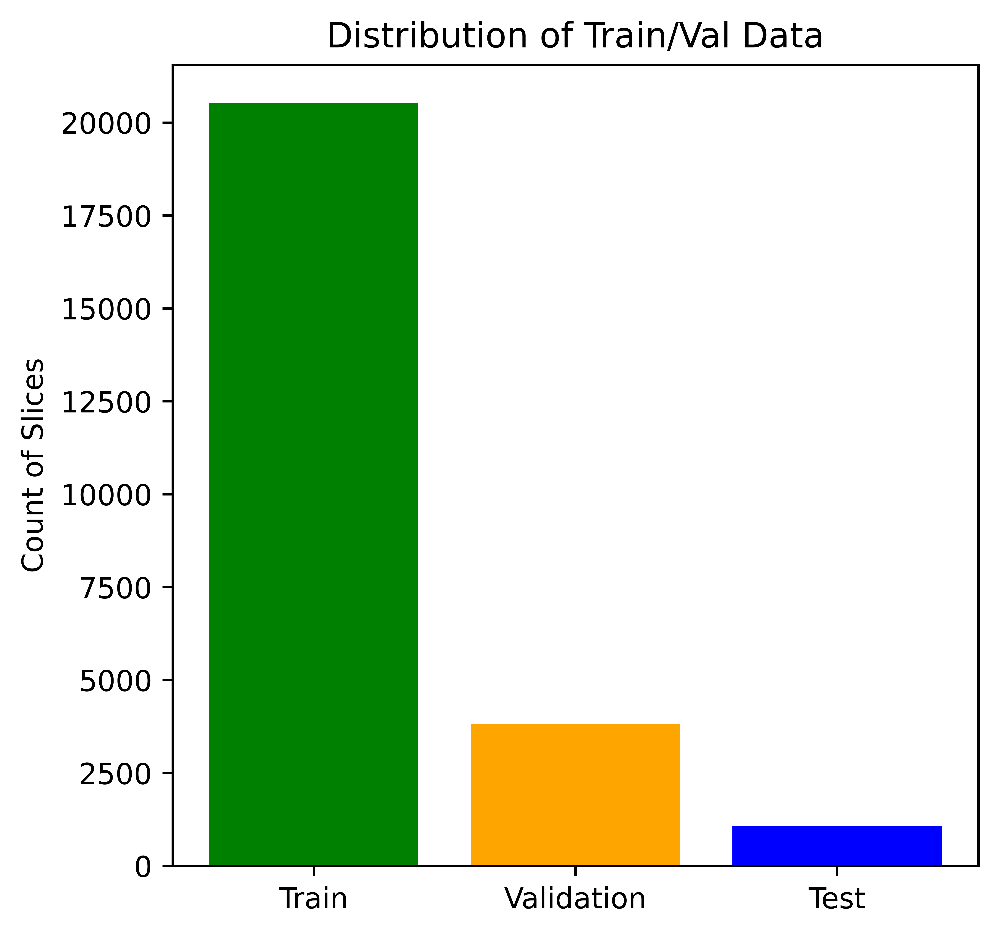

In [26]:
lables=["Train","Validation","Test"]
data=[len(train_files),len(val_files),len(test_files)]
plt.figure(figsize=(5,5),dpi=1000)
plt.bar(lables,data,color=['green','orange','blue'])
plt.title("Distribution of Train/Val Data")
plt.ylabel("Count of Slices")
plt.show()

Visualizing a few TRAIN slices:


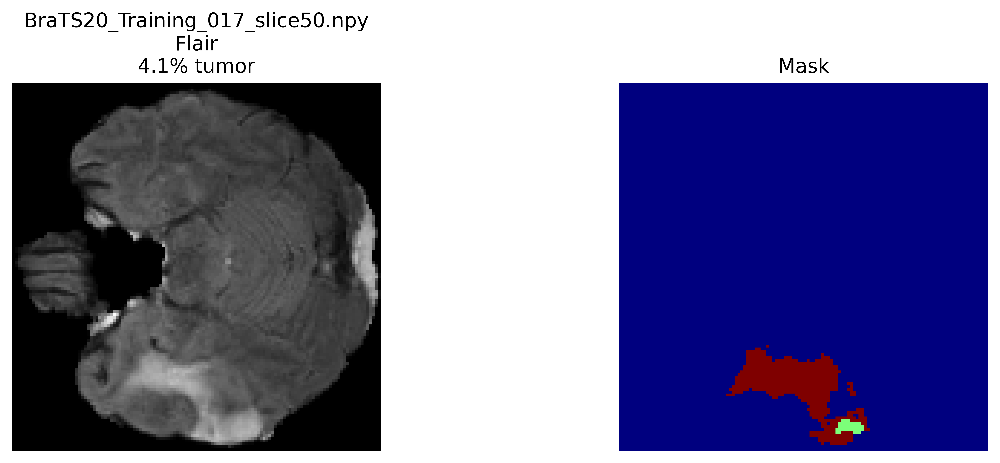

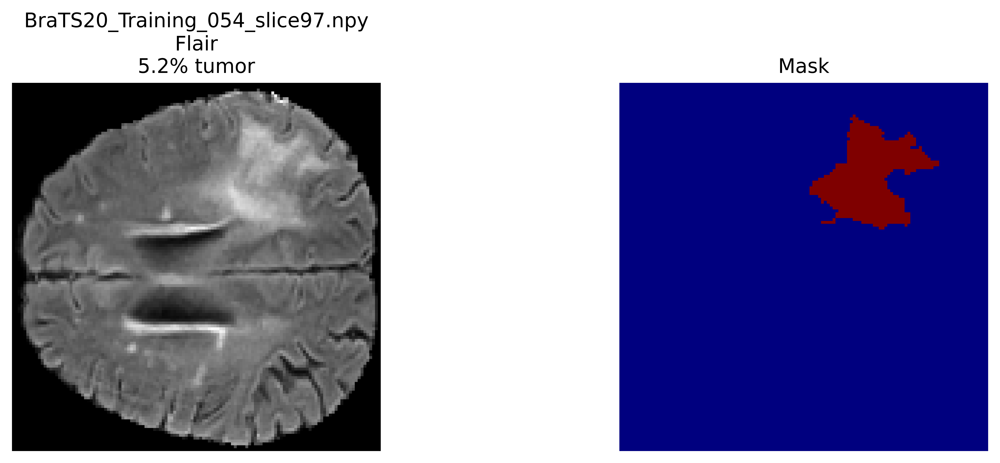

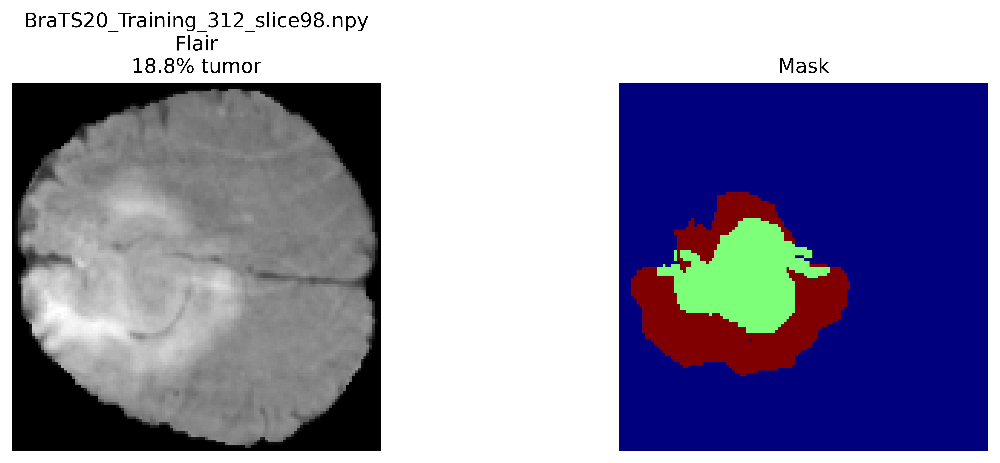

Visualizing a few VAL slices:


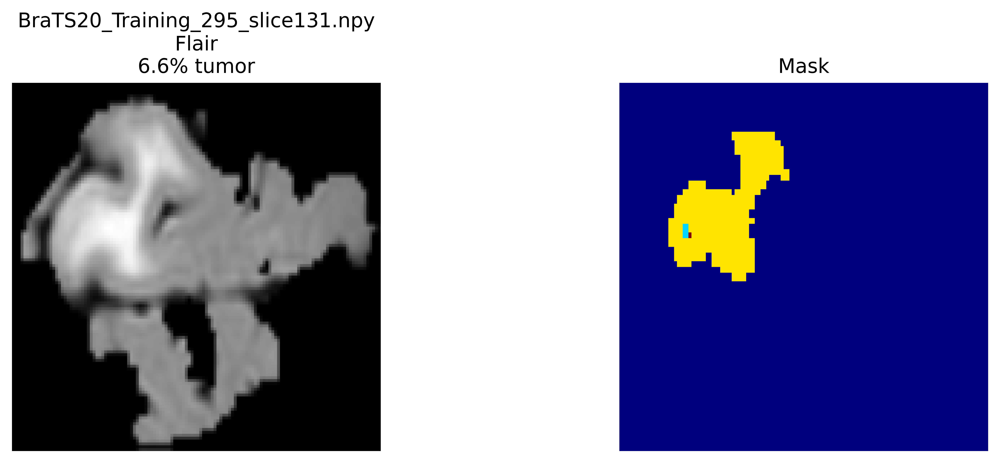

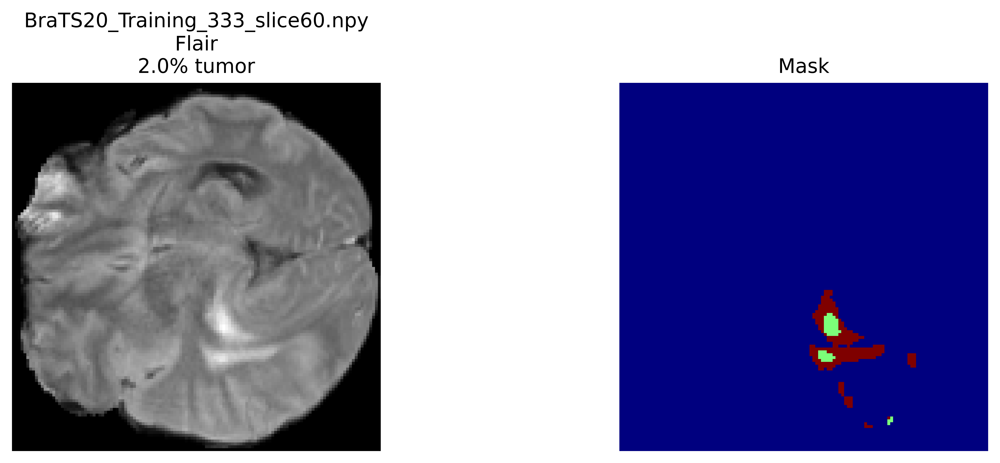

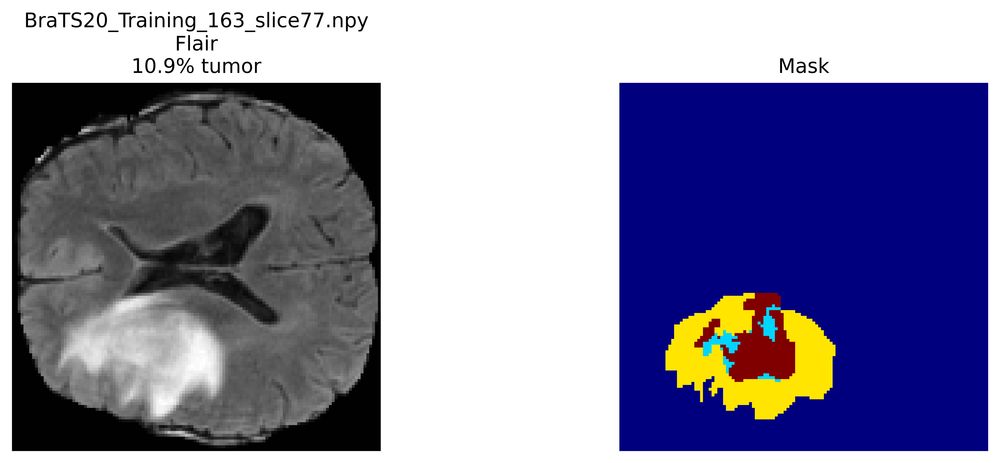

In [27]:
def visualize_random_slices(images_dir, masks_dir, file_list, num_samples=3):
    sample_files = random.sample(file_list, k=min(num_samples, len(file_list)))
    for fname in sample_files:
        img_path  = os.path.join(images_dir, fname)
        msk_path  = os.path.join(masks_dir, fname)

        img_4ch  = np.load(img_path)
        mask_1hot= np.load(msk_path)
        lbl_2d   = np.argmax(mask_1hot, axis=-1)
        coverage = np.count_nonzero(lbl_2d>0)/float(lbl_2d.size)

        plt.figure(figsize=(12,4),dpi=1000)
        plt.subplot(1,2,1)
        plt.imshow(img_4ch[...,0], cmap='gray')  # Flair
        plt.title(f"{fname}\nFlair\n{coverage*100:.1f}% tumor")
        plt.axis('off')

        #plt.subplot(1,2,2)
        #plt.imshow(img_4ch[...,1], cmap='gray')  # T1
        ##plt.axis('off')

        plt.subplot(1,2,2)
        plt.imshow(lbl_2d, cmap='jet')
        plt.title("Mask")
        plt.axis('off')
        plt.show()

# Show some train slices
print("Visualizing a few TRAIN slices:")
visualize_random_slices(
    images_dir=os.path.join(SAVE_DIR, "images"),
    masks_dir=os.path.join(SAVE_DIR, "masks"),
    file_list=train_files,
    num_samples=3
)

# Show some validation slices
print("Visualizing a few VAL slices:")
visualize_random_slices(
    images_dir=os.path.join(SAVE_DIR, "images"),
    masks_dir=os.path.join(SAVE_DIR, "masks"),
    file_list=val_files,
    num_samples=3
)

Visualizing a few TRAIN slices:


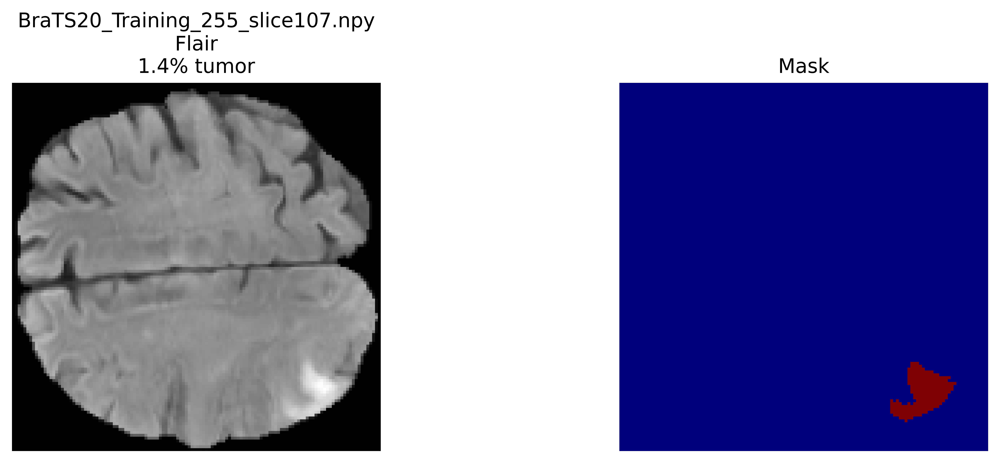

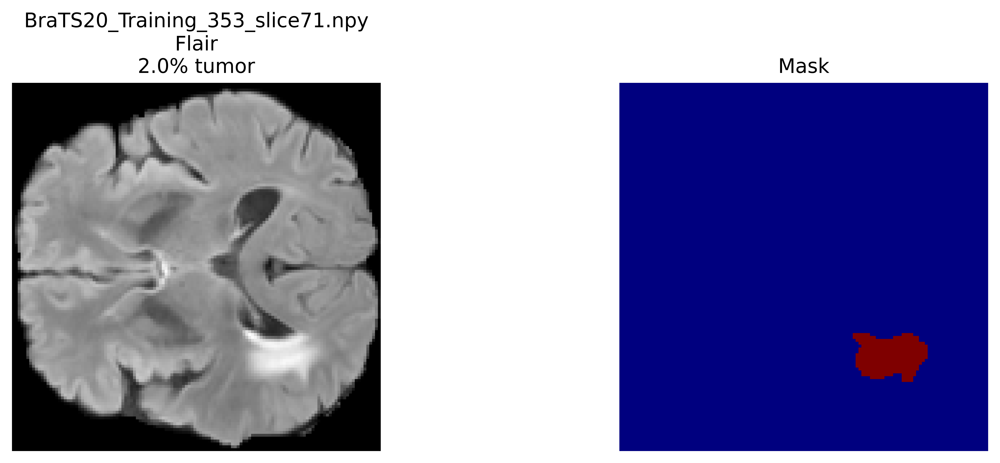

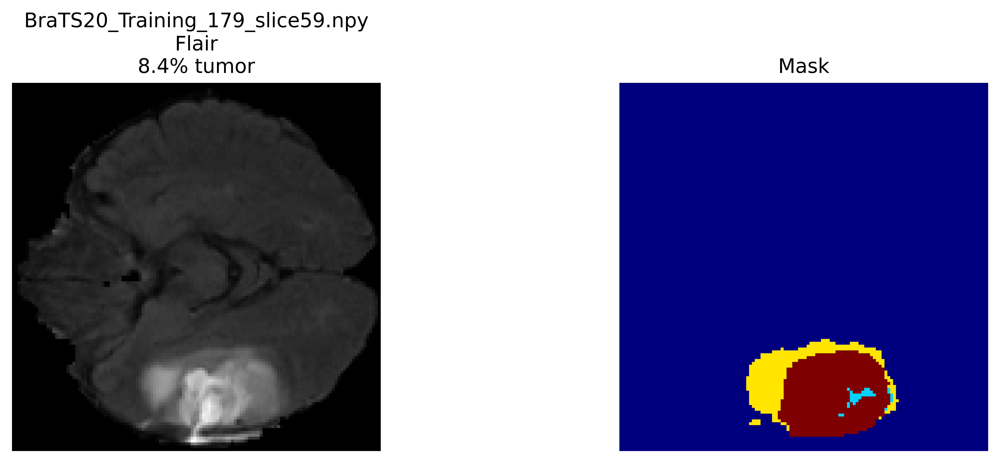

Visualizing a few VAL slices:


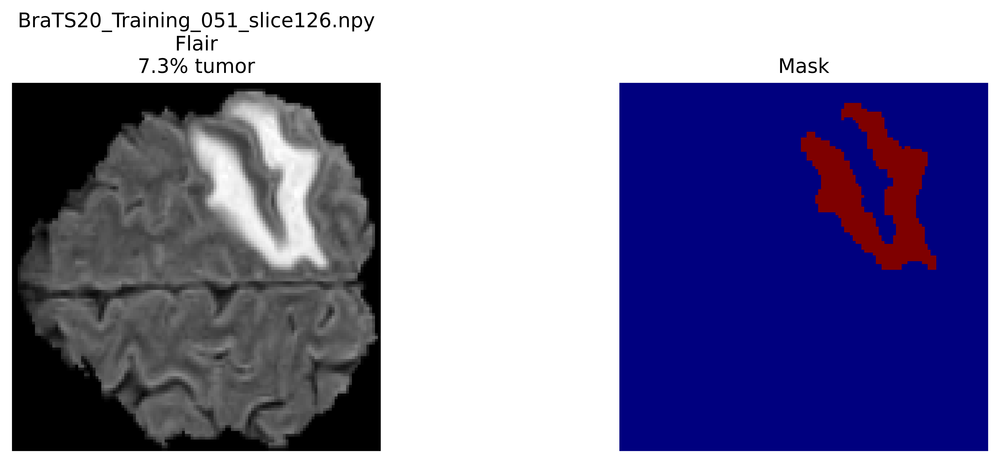

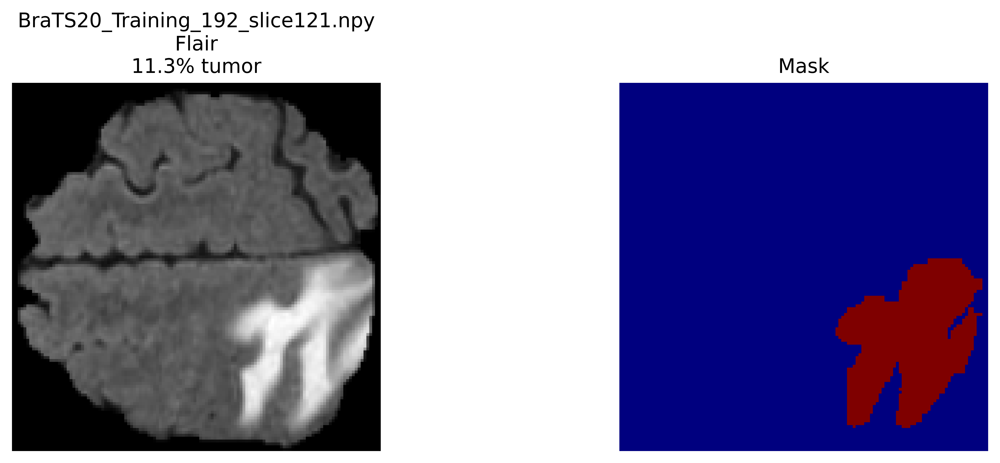

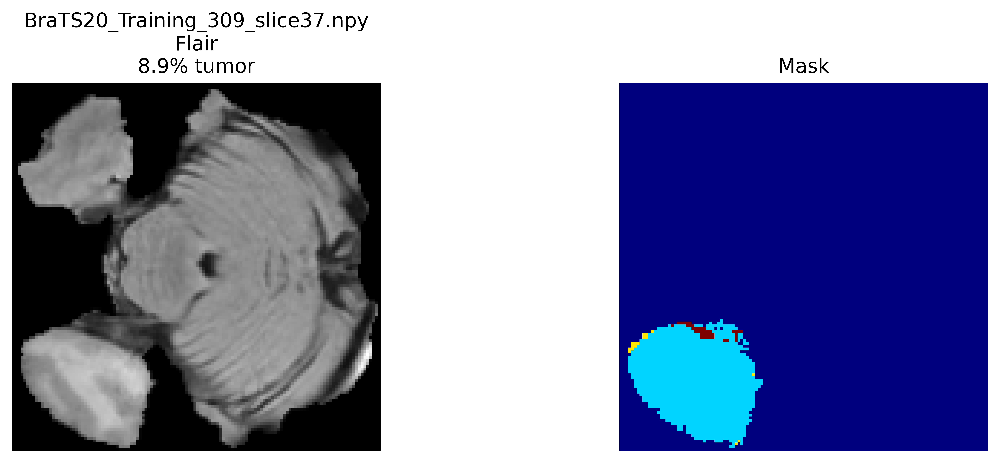

In [28]:
def visualize_random_slices(images_dir, masks_dir, file_list, num_samples=3):
    sample_files = random.sample(file_list, k=min(num_samples, len(file_list)))
    for fname in sample_files:
        img_path  = os.path.join(images_dir, fname)
        msk_path  = os.path.join(masks_dir, fname)

        img_4ch  = np.load(img_path)
        mask_1hot= np.load(msk_path)
        lbl_2d   = np.argmax(mask_1hot, axis=-1)
        coverage = np.count_nonzero(lbl_2d>0)/float(lbl_2d.size)

        plt.figure(figsize=(12,4),dpi=1000)
        plt.subplot(1,2,1)
        plt.imshow(img_4ch[...,0], cmap='gray')  # Flair
        plt.title(f"{fname}\nFlair\n{coverage*100:.1f}% tumor")
        plt.axis('off')

        #plt.subplot(1,2,2)
        #plt.imshow(img_4ch[...,1], cmap='gray')  # T1
        ##plt.axis('off')

        plt.subplot(1,2,2)
        plt.imshow(lbl_2d, cmap='jet')
        plt.title("Mask")
        plt.axis('off')
        plt.show()

# Show some train slices
print("Visualizing a few TRAIN slices:")
visualize_random_slices(
    images_dir=os.path.join(SAVE_DIR, "images"),
    masks_dir=os.path.join(SAVE_DIR, "masks"),
    file_list=train_files,
    num_samples=3
)

# Show some validation slices
print("Visualizing a few VAL slices:")
visualize_random_slices(
    images_dir=os.path.join(SAVE_DIR, "images"),
    masks_dir=os.path.join(SAVE_DIR, "masks"),
    file_list=val_files,
    num_samples=3
)

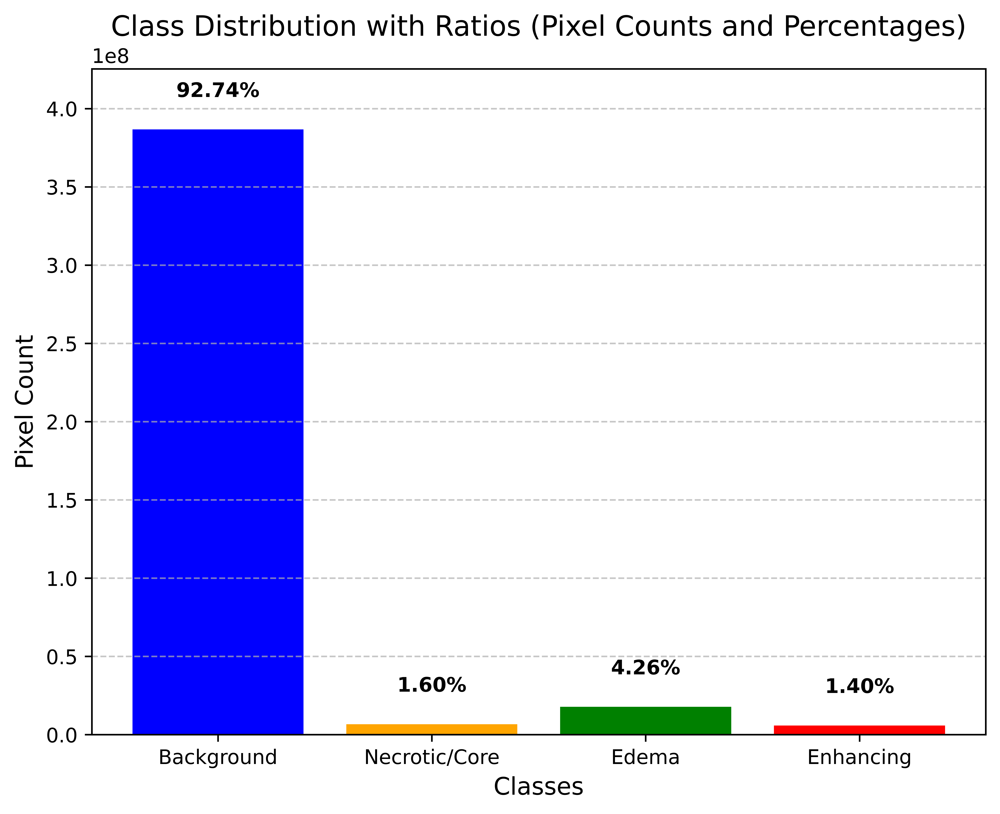

Background: 386678461 pixels (92.74%)
Necrotic/Core: 6664807 pixels (1.60%)
Edema: 17762868 pixels (4.26%)
Enhancing: 5835432 pixels (1.40%)


In [29]:
def compute_class_distribution(masks_dir, max_files=None):
    """
    Go through all .npy mask files (one-hot),
    count how many pixels in each class.
    """
    all_files = [f for f in os.listdir(masks_dir) if f.endswith('.npy')]
    if max_files is not None:
        all_files = all_files[:max_files]
    
    total_counts = np.zeros(4, dtype=np.int64)  # for 4 classes

    for fname in all_files:
        m = np.load(os.path.join(masks_dir, fname))  # shape (H, W, 4)
        # Convert to label
        label_2d = np.argmax(m, axis=-1)  # shape (H, W)
        for c in range(4):
            total_counts[c] += np.sum(label_2d == c)

    return total_counts

# Compute pixel counts
masks_path = "/kaggle/temp/preprocessed_data/masks"
counts = compute_class_distribution(masks_path)

# Calculate total pixels and ratios
total_pixels = np.sum(counts)
ratios = counts / total_pixels

# Labels
labels = ['Background', 'Necrotic/Core', 'Edema', 'Enhancing']

# Visualize as a bar plot with ratios
plt.figure(figsize=(8, 6),dpi=1000)
bars = plt.bar(labels, counts, color=['blue', 'orange', 'green', 'red'])

# Annotate bars with percentage ratios
for bar, ratio in zip(bars, ratios):
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        height + 0.05 * total_pixels,  # Slightly above the bar
        f"{ratio * 100:.2f}%",  # Convert ratio to percentage
        ha='center',
        fontsize=10,
        fontweight='bold'
    )

plt.title("Class Distribution with Ratios (Pixel Counts and Percentages)", fontsize=14)
plt.xlabel("Classes", fontsize=12)
plt.ylabel("Pixel Count", fontsize=12)
plt.ylim(0, max(counts) * 1.1)  # Add padding to the y-axis for annotations
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# Print counts and ratios
for label, count, ratio in zip(labels, counts, ratios):
    print(f"{label}: {count} pixels ({ratio * 100:.2f}%)")

In [30]:
train_big   = [f for f in train_files if f in all_big_slices]
train_small = [f for f in train_files if f in all_small_slices]

print("Train subset breakdown:")
print(f"  Big slices:   {len(train_big)}")
print(f"  Small slices: {len(train_small)}")

import cv2
 
# Extended Augmentations
all_transforms = A.Compose([
    A.HorizontalFlip(p=1.0),
    A.VerticalFlip(p=1.0),
    A.RandomRotate90(p=0.5),
    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=15, p=0.5),
    A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=0.5),
])

'''all_transforms = A.Compose(
    [
        A.Rotate(limit=30, interpolation=cv2.INTER_LINEAR, border_mode=cv2.BORDER_REFLECT, p=1.0),
        A.HorizontalFlip(p=1.0),
        A.VerticalFlip(p=1.0),
        A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.15, p=1.0),
        A.ShiftScaleRotate(
            shift_limit=0.05, scale_limit=0.1, rotate_limit=15,
            interpolation=cv2.INTER_LINEAR, border_mode=cv2.BORDER_REFLECT, p=1.0
        ),
        A.RandomGamma(gamma_limit=(80, 120), p=1.0),
        A.ElasticTransform(
            alpha=2, sigma=50,
            interpolation=cv2.INTER_LINEAR,
            mask_interpolation=cv2.INTER_NEAREST,
            border_mode=cv2.BORDER_REFLECT,
            p=1.0
        ),
        A.GaussNoise(var_limit=(5.0, 20.0), p=1.0),
        A.GridDistortion(num_steps=5, distort_limit=0.3, p=1.0),
        A.CLAHE(clip_limit=2.0, tile_grid_size=(8,8), p=1.0)
    ],
    additional_targets={
        "image1": "image",
        "image2": "image",
        "image3": "image",
    }
)
'''

class OversampleAllAugGenerator(Sequence):
    """
    1) Oversamples big tumor slices vs. small tumor slices.
    2) Applies all transformations in 'all_transforms' pipeline to each slice.
    """

    def __init__(
        self,
        big_slices, small_slices,
        images_dir, masks_dir,
        batch_size=8,
        big_frac=0.5,
        shuffle=True,
        augment=True
    ):
        self.big_slices   = big_slices
        self.small_slices = small_slices
        self.images_dir   = images_dir
        self.masks_dir    = masks_dir
        self.batch_size   = batch_size
        self.big_count    = int(self.batch_size * big_frac)
        self.small_count  = self.batch_size - self.big_count
        self.shuffle      = shuffle
        self.augment      = augment
        self.on_epoch_end()

    def on_epoch_end(self):
        # Shuffle big_slices, small_slices if needed
        if self.shuffle:
            random.shuffle(self.big_slices)
            random.shuffle(self.small_slices)

    def __len__(self):
        # Arbitrary steps per epoch. 
        # If you prefer a full pass, do len(...)//batch_size
        return 240

    def __getitem__(self, idx):
        chosen_big   = np.random.choice(self.big_slices,   size=self.big_count,   replace=True)
        chosen_small = np.random.choice(self.small_slices, size=self.small_count, replace=True)
        batch_files  = list(chosen_big) + list(chosen_small)
        random.shuffle(batch_files)

        X, Y = [], []
        for fname in batch_files:
            img_path  = os.path.join(self.images_dir, fname)
            mask_path = os.path.join(self.masks_dir,  fname)

            img_4ch  = np.load(img_path)
            mask_1hot= np.load(mask_path)
            label_2d = np.argmax(mask_1hot, axis=-1).astype(np.uint8)

            if self.augment:
                # Using additional_targets in Albumentations
                transform = A.Compose([
                    #A.Flip(p=0.5),
                    A.RandomRotate90(p=0.5),
                    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=15, p=0.5),
                    A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=0.5),
                ], additional_targets={
                    "image2": "image",
                    "image3": "image",
                    "image4": "image",
                })
                aug_in = {
                    "image":  img_4ch[...,0],
                    "image2": img_4ch[...,1],
                    "image3": img_4ch[...,2],
                    "image4": img_4ch[...,3],
                    "mask":   label_2d
                }
                augmented = transform(**aug_in)
                c0 = augmented["image"]
                c1 = augmented["image2"]
                c2 = augmented["image3"]
                c3 = augmented["image4"]
                aug_mask_2d = augmented["mask"]

                aug_img_4ch = np.stack([c0,c1,c2,c3], axis=-1)
                H_,W_ = aug_mask_2d.shape
                aug_mask_1hot = np.eye(N_CLASSES)[aug_mask_2d.reshape(-1)].reshape(H_,W_,N_CLASSES)

                X.append(aug_img_4ch)
                Y.append(aug_mask_1hot)
            else:
                X.append(img_4ch)
                Y.append(mask_1hot)

        return np.array(X, dtype=np.float32), np.array(Y, dtype=np.float32)


class SimpleDataGenerator(Sequence):
    def __init__(self, file_list, images_dir, masks_dir, batch_size=8):
        self.file_list  = file_list
        self.images_dir = images_dir
        self.masks_dir  = masks_dir
        self.batch_size = batch_size

    def __len__(self):
        
        return (len(self.file_list) + self.batch_size - 1) // self.batch_size


    def __getitem__(self, idx):
        batch_f = self.file_list[idx*self.batch_size : (idx+1)*self.batch_size]
        X, Y = [], []
        for fname in batch_f:
            img_4ch  = np.load(os.path.join(self.images_dir, fname))
            mask_1hot= np.load(os.path.join(self.masks_dir, fname))
            X.append(img_4ch)
            Y.append(mask_1hot)
        return np.array(X, dtype=np.float32), np.array(Y, dtype=np.float32)

Train subset breakdown:
  Big slices:   15080
  Small slices: 5451


/usr/local/lib/python3.11/dist-packages/albumentations/core/validation.py:87: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)


In [31]:
augmentations_list = A.Compose([
    A.HorizontalFlip(p=1.0),
    A.VerticalFlip(p=1.0),
    A.RandomRotate90(p=0.5),
    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=15, p=0.5),
    A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=0.5),
])



def visualize_augmentations(images_dir, masks_dir, file_list, num_samples=2):
    """
    For 'num_samples' random slices from file_list:
      - Load the original image (4-channel) & mask
      - For each augmentation, apply it individually
      - Display the original + augmented versions with titles for each augmentation
    """
    sample_files = random.sample(file_list, k=min(num_samples, len(file_list)))

    for f in sample_files:
        # Load original .npy
        img_path = os.path.join(images_dir, f)
        mask_path = os.path.join(masks_dir, f)
        img_4ch = np.load(img_path)  # shape (H, W, 4)
        mask_1hot = np.load(mask_path)  # shape (H, W, 4)

        # Convert mask to label for augmentation
        mask_label = np.argmax(mask_1hot, axis=-1).astype(np.uint8)

        # We'll store images in a list: [original, aug1, aug2, ...]
        augmented_images = [img_4ch]
        augmented_labels = [mask_label]

        # For each augmentation, apply it
        for aug in augmentations_list:
            transform = A.Compose(
                [aug],
                additional_targets={
                    "image1": "image",
                    "image2": "image",
                    "image3": "image"
                }
            )
            aug_in = {
                "image": img_4ch[..., 0],
                "image1": img_4ch[..., 1],
                "image2": img_4ch[..., 2],
                "image3": img_4ch[..., 3],
                "mask": mask_label
            }
            output = transform(**aug_in)

            # Reassemble augmented image
            c0 = output["image"]
            c1 = output["image1"]
            c2 = output["image2"]
            c3 = output["image3"]
            out_img_4ch = np.stack([c0, c1, c2, c3], axis=-1)
            out_mask_lbl = output["mask"]

            augmented_images.append(out_img_4ch)
            augmented_labels.append(out_mask_lbl)

        # Display original + augmented images and masks
        num_augmentations = len(augmentations_list) + 1
        plt.figure(figsize=(24, 10),dpi=1000)  # Larger figure size for better visibility

        # Flair channel visualizations
        for i in range(num_augmentations):
            plt.subplot(2, num_augmentations, i + 1)
            plt.imshow(augmented_images[i][..., 0], cmap="gray")
            if i == 0:
                plt.title("Original Flair", fontsize=14)
            else:
                plt.title(augmentations_list[i - 1].__class__.__name__, fontsize=14)
            plt.axis("off")

        

# Run the visualization with updated augmentations
visualize_augmentations(
    images_dir=os.path.join(SAVE_DIR, "images"),
    masks_dir=os.path.join(SAVE_DIR, "masks"),
    file_list=train_files,  # or val_files
    num_samples=3
)

In [32]:
train_gen = OversampleAllAugGenerator(
    big_slices=train_big,
    small_slices=train_small,
    images_dir=os.path.join(SAVE_DIR, "images"),
    masks_dir=os.path.join(SAVE_DIR, "masks"),
    batch_size=BATCH_SIZE,
    big_frac=0.5,
    shuffle=True,
    augment=True
)
val_gen = SimpleDataGenerator(
    val_files,
    images_dir=os.path.join(SAVE_DIR, "images"),
    masks_dir=os.path.join(SAVE_DIR, "masks"),
    batch_size=BATCH_SIZE
)

In [33]:
strategy = tf.distribute.MirroredStrategy()
print("Number of devices: ", strategy.num_replicas_in_sync)

Number of devices:  1


I0000 00:00:1765727479.279894      37 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


In [34]:
def attention_gate(x, g, filters):
    theta_x = layers.Conv2D(filters, 1, padding='same')(x)
    phi_g = layers.Conv2D(filters, 1, padding='same')(g)
    
    add = layers.Add()([theta_x, phi_g])
    act = layers.ReLU()(add)
    
    psi = layers.Conv2D(1, 1, padding='same', activation='sigmoid')(act)
    
    return layers.Multiply()([x, psi])

def unet_conv_block(x, filters):
    x = layers.Conv2D(filters, 3, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    
    x = layers.Conv2D(filters, 3, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    
   
    return x

def build_unet(input_shape=(240, 240, 4), num_classes=4):
    inputs = layers.Input(shape=input_shape)
    
    c1 = unet_conv_block(inputs, 64)
    p1 = layers.MaxPooling2D()(c1)
    
    c2 = unet_conv_block(p1, 128)
    p2 = layers.MaxPooling2D()(c2)
    
    c3 = unet_conv_block(p2, 256)
    p3 = layers.MaxPooling2D()(c3)
    
    c4 = unet_conv_block(p3, 512)
    p4 = layers.MaxPooling2D()(c4)
    
    c5 = unet_conv_block(p4, 512)
    
    u1 = layers.UpSampling2D()(c5)
    c4 = attention_gate(c4, u1, 512)
    u1 = layers.concatenate([u1, c4], axis=-1)
    c6 = unet_conv_block(u1, 512)
    
    u2 = layers.UpSampling2D()(c6)
    c3 = attention_gate(c3, u2, 256)
    u2 = layers.concatenate([u2, c3], axis=-1)
    c7 = unet_conv_block(u2, 256)
    
    u3 = layers.UpSampling2D()(c7)
    c2 = attention_gate(c2, u3, 128)
    u3 = layers.concatenate([u3, c2], axis=-1)
    c8 = unet_conv_block(u3, 128)
    
    u4 = layers.UpSampling2D()(c8)
    c1 = attention_gate(c1, u4, 64)
    u4 = layers.concatenate([u4, c1], axis=-1)
    c9 = unet_conv_block(u4, 64)
    
    outputs = layers.Conv2D(num_classes, 1, activation='softmax')(c9)
    
    return Model(inputs, outputs)

In [35]:
@tf.function
def dice_coefficient(y_true, y_pred, smooth=1e-6):
    """
    Computes the mean Dice Coefficient over all classes.
    Expects y_true and y_pred in [Batch, Height, Width, Classes] format (one-hot).
    """
    # Clip predictions to avoid log(0) in some edge cases
    y_pred = tf.clip_by_value(y_pred, smooth, 1.0 - smooth)
    
    # Calculate per-class dice
    intersection = tf.reduce_sum(y_true * y_pred, axis=[0,1,2])  # sum across batch+spatial dims
    union        = tf.reduce_sum(y_true + y_pred, axis=[0,1,2])
    dice_per_class = (2. * intersection + smooth) / (union + smooth)

    # Average across classes
    return tf.reduce_mean(dice_per_class)



@tf.function
def tversky_index(y_true, y_pred, alpha=0.9, beta=0.1, smooth=1e-6):
    """
    Tversky index for multi-class one-hot or binary masks.
    alpha,beta: controls weighting of FP vs FN.
    y_true, y_pred: shape (batch, H, W, classes)
    """
    # Flatten
    y_true_f = tf.reshape(y_true, [-1])
    y_pred_f = tf.reshape(y_pred, [-1])

    # Tversky
    tp = tf.reduce_sum(y_true_f * y_pred_f)
    fp = tf.reduce_sum((1 - y_true_f) * y_pred_f)
    fn = tf.reduce_sum(y_true_f * (1 - y_pred_f))

    return (tp + smooth) / (tp + alpha*fp + beta*fn + smooth)


@tf.function
def focal_tversky_loss(y_true, y_pred, alpha=0.9, beta=0.1, gamma=4/3, smooth=1e-6):
    """
    Focal Tversky Loss = (1 - Tversky)**gamma
    alpha,beta: Tversky weighting. gamma>1 => strong focus on misclassified regions.
    """
    ti = tversky_index(y_true, y_pred, alpha=alpha, beta=beta, smooth=smooth)
    return tf.pow((1 - ti), gamma)

# Callback for Per-Class Dice
class PerClassDiceCallback(tf.keras.callbacks.Callback):
    def __init__(self, generator, steps=5, label="val"):
        super().__init__()
        self.gen = generator
        self.steps = steps
        self.label = label

    def on_epoch_end(self, epoch, logs=None):
        import numpy as np
        total_intersection = np.zeros(N_CLASSES, dtype=np.float64)
        total_union        = np.zeros(N_CLASSES, dtype=np.float64)

        for i in range(self.steps):
            Xb, Yb = next(iter(self.gen))
            Pb = self.model.predict(Xb, verbose=0)
            for b in range(len(Xb)):
                y_true = Yb[b]  # shape (H,W,4)
                y_pred = Pb[b]  # shape (H,W,4)
                intersection = np.sum(y_true*y_pred, axis=(0,1))
                union        = np.sum(y_true+y_pred, axis=(0,1))
                total_intersection += intersection
                total_union        += union

        dice_per_class = (2.*total_intersection + 1e-6)/(total_union + 1e-6)
        msg = [f"Class {c}={dice_per_class[c]:.4f}" for c in range(N_CLASSES)]
        print(f"\nEpoch {epoch+1} {self.label}-Dice:", ", ".join(msg))

        for c in range(N_CLASSES):
            logs[f"{self.label}_dice_class{c}"] = dice_per_class[c]

In [36]:
with strategy.scope():
    model = build_unet(input_shape=(IMG_HEIGHT, IMG_WIDTH, N_CHANNELS))
    model.compile(
        optimizer=Adam(1e-4),
        loss=focal_tversky_loss,
        metrics=[
            "accuracy",
            dice_coefficient,
        ]
    )
    
    checkpoint_cb = ModelCheckpoint(
        "/kaggle/working/best_unet_model.keras",
        monitor="val_loss",
        save_best_only=True,
        verbose=1
    )
    reduce_lr_cb = ReduceLROnPlateau(
        monitor="val_loss",
        factor=0.5,
        patience=5,
        min_lr=1e-6,
        verbose=1
    )
    dice_cb = PerClassDiceCallback(val_gen, steps=5, label="val")
    EPOCHS=10
    history = model.fit(
        train_gen,
        validation_data=val_gen,
        epochs=EPOCHS,
        callbacks=[checkpoint_cb, reduce_lr_cb, dice_cb]
    )

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10


I0000 00:00:1765727492.150127     100 cuda_dnn.cc:529] Loaded cuDNN version 90300


240/240 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step - accuracy: 0.8655 - dice_coefficient: 0.2977 - loss: 0.1857
Epoch 1: val_loss improved from inf to 0.08024, saving model to /kaggle/working/best_unet_model.keras

Epoch 1 val-Dice: Class 0=0.9338, Class 1=0.1604, Class 2=0.3819, Class 3=0.0261
240/240 ━━━━━━━━━━━━━━━━━━━━ 83s 278ms/step - accuracy: 0.8658 - dice_coefficient: 0.2979 - loss: 0.1854 - val_accuracy: 0.9512 - val_dice_coefficient: 0.3728 - val_loss: 0.0802 - learning_rate: 1.0000e-04 - val_dice_class0: 0.9338 - val_dice_class1: 0.1604 - val_dice_class2: 0.3819 - val_dice_class3: 0.0261
Epoch 2/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step - accuracy: 0.9682 - dice_coefficient: 0.4215 - loss: 0.0415
Epoch 2: val_loss improved from 0.08024 to 0.02986, saving model to /kaggle/working/best_unet_model.keras

Epoch 2 val-Dice: Class 0=0.9751, Class 1=0.3792, Class 2=0.5875, Class 3=0.0699
240/240 ━━━━━━━━━━━━━━━━━━━━ 63s 263ms/step - accuracy: 0.9682 - dice_coefficient: 0.4216 - loss: 0

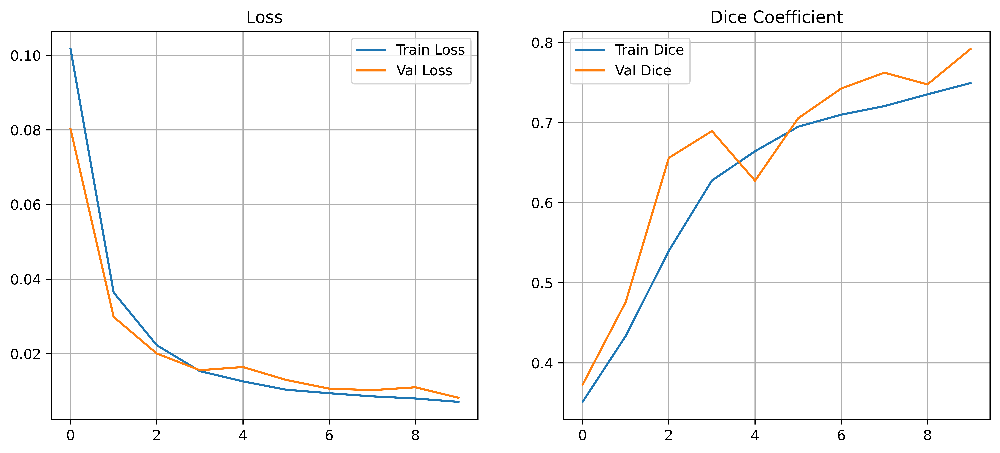

In [37]:
import matplotlib.pyplot as plt

def plot_history(history):
    # Create a figure with two subplots side-by-side
    plt.figure(figsize=(12, 5),dpi=1000)

    # Subplot 1: Loss
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Val Loss')
    plt.title("Loss")
    plt.legend()
    plt.grid(True)

    # Subplot 2: Dice Coefficient
    # Check if 'dice_coefficient' is in the history keys
    if 'dice_coefficient' in history.history:
        plt.subplot(1, 2, 2)
        plt.plot(history.history['dice_coefficient'], label='Train Dice')
        plt.plot(history.history['val_dice_coefficient'], label='Val Dice')
        plt.title("Dice Coefficient")
        plt.legend()
        plt.grid(True)

    # Save the plot to a file
    plt.savefig('/kaggle/working/TrainingLog(TFL).jpg')

    # Display the plot
    plt.show()


plot_history(history)

In [38]:
# Evaluate the model on the validation set
val_loss, val_accuracy, val_dice = history.model.evaluate(val_gen, verbose=1)

print(f"Validation Loss: {val_loss}")
print(f"Validation Accuracy: {val_accuracy}")
print(f"Validation Dice Coefficient: {val_dice}")

239/239 ━━━━━━━━━━━━━━━━━━━━ 15s 56ms/step - accuracy: 0.9774 - dice_coefficient: 0.7918 - loss: 0.0080
Validation Loss: 0.008166762068867683
Validation Accuracy: 0.9771348237991333
Validation Dice Coefficient: 0.7919335961341858


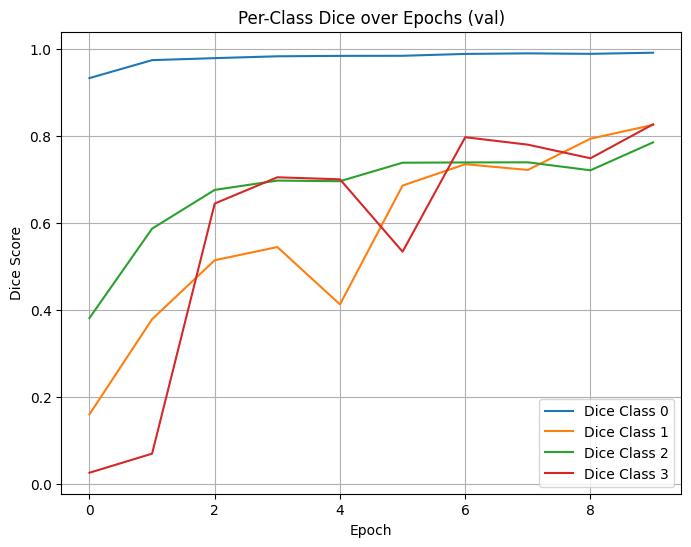

<Figure size 640x480 with 0 Axes>

In [39]:
import matplotlib.pyplot as plt

def plot_per_class_dice(history, n_classes=4, label_prefix="val", figsize=(8,6)):
    """
    Plots the per-class dice curves from history for each epoch.
    Args:
      history: the History object returned by model.fit(...)
      n_classes: number of classes
      label_prefix: "val" if you want to plot validation curves,
                    or "train" if you had logs for training dice
      figsize: figure size
    """
    plt.figure(figsize=figsize)
    
    for c in range(n_classes):
        key = f"{label_prefix}_dice_class{c}"
        if key in history.history:
            plt.plot(history.history[key], label=f"Dice Class {c}")
        else:
            print(f"Warning: Key '{key}' not found in history. Skipping class {c}.")

    plt.title(f"Per-Class Dice over Epochs ({label_prefix})")
    plt.xlabel("Epoch")
    plt.ylabel("Dice Score")
    plt.legend()
    plt.grid(True)
    plt.show()
    plt.savefig('/kaggle/working/DicescorePerClass(FTL).png')
# Example usage:
plot_per_class_dice(history, n_classes=4, label_prefix="val")

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


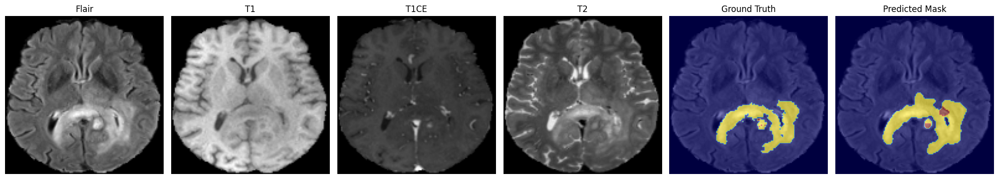

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step


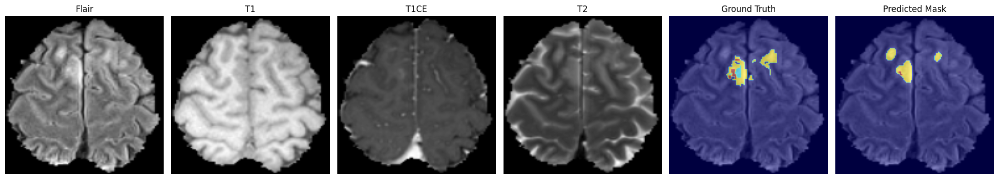

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step


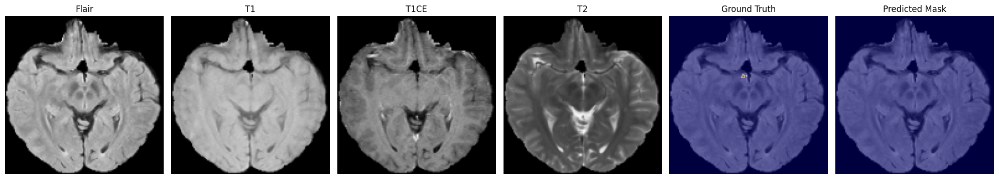

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


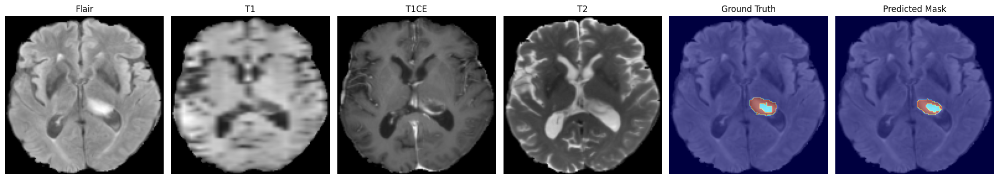

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


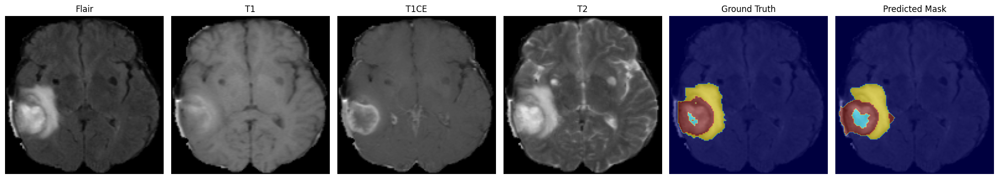

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


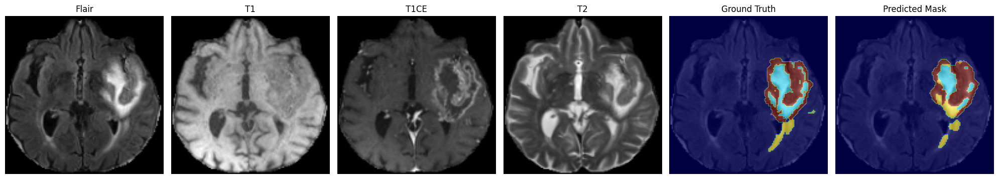

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step


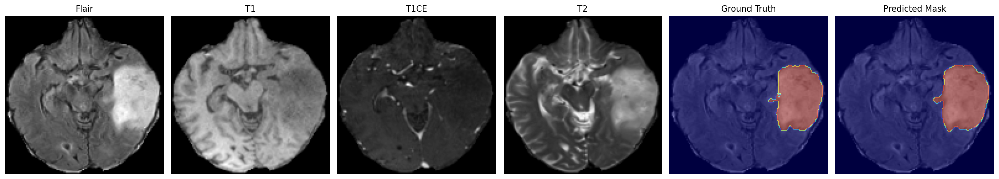

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step


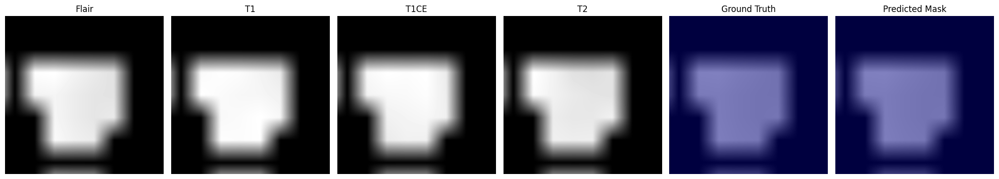

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


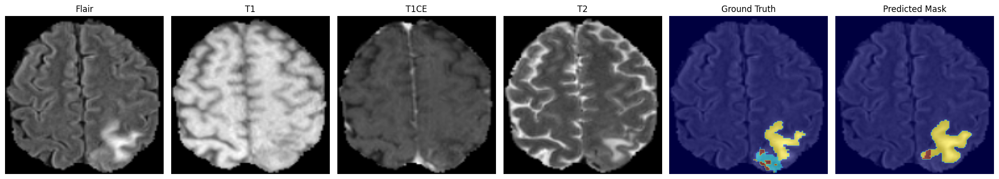

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 160ms/step


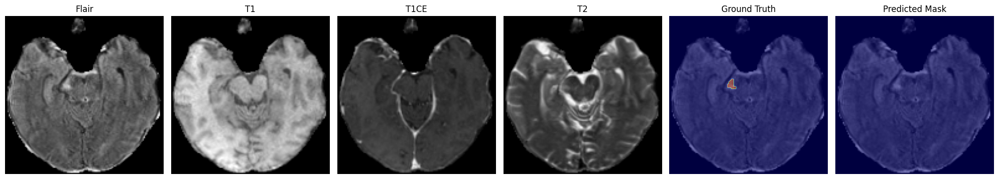

In [40]:
def visualize_predictions(model, images_dir, masks_dir, patient_files, num_patients=3, slice_offset=2):
    """
    Visualize predictions for a few patients:
    - Six images in one row: Flair, T1, T1CE, T2, Flair + Ground Truth, Flair + Predicted Mask.
    - All images rotated 90 degrees clockwise.

    Args:
        model: Trained model to predict the segmentation masks.
        images_dir: Path to the directory containing preprocessed image slices.
        masks_dir: Path to the directory containing preprocessed mask slices.
        patient_files: List of all files (e.g., [patientID_sliceX.npy]).
        num_patients: Number of patients to visualize.
        slice_offset: How many slices before and after the middle slice to select.
    """
    import random

    # Get unique patient IDs from the filenames
    patient_ids = list(set([f.split('_slice')[0] for f in patient_files]))
    random.shuffle(patient_ids)

    for patient_id in patient_ids[:num_patients]:
        # Get all slices for the patient
        patient_slices = [f for f in patient_files if f.startswith(patient_id)]
        patient_slices.sort()  # Sort slices numerically (optional)

        # Find middle slice index and pick slices around it
        middle_idx = len(patient_slices) // 2
        selected_slices = patient_slices[max(0, middle_idx - slice_offset): min(len(patient_slices), middle_idx + slice_offset + 1)]

        for f in selected_slices:
            img_path = os.path.join(images_dir, f)
            mask_path = os.path.join(masks_dir, f)

            img_4ch = np.load(img_path)  # (H, W, 4)
            msk_1hot = np.load(mask_path)  # (H, W, 4)
            gt_label = np.argmax(msk_1hot, axis=-1)

            # Predict the mask
            pred_soft = model.predict(img_4ch[None, ...])[0]  # (H, W, 4)
            pred_label = np.argmax(pred_soft, axis=-1)

            plt.figure(figsize=(20, 5))  # Adjust width to fit 6 images in one row

            # Show all four modalities
            modality_names = ["Flair", "T1", "T1CE", "T2"]
            for i in range(4):
                plt.subplot(1, 6, i + 1)
                plt.imshow(np.rot90(img_4ch[..., i], k=3), cmap='gray')  # Rotate 90° clockwise
                plt.title(modality_names[i])
                plt.axis('off')

            # Flair with Ground Truth overlay
            plt.subplot(1, 6, 5)
            plt.imshow(np.rot90(img_4ch[..., 0], k=3), cmap='gray')  # Rotate 90° clockwise
            plt.imshow(np.rot90(gt_label, k=3), cmap='jet', alpha=0.5)  # Ground Truth overlay
            plt.title("Ground Truth")
            plt.axis('off')

            # Flair with Predicted Mask overlay
            plt.subplot(1, 6, 6)
            plt.imshow(np.rot90(img_4ch[..., 0], k=3), cmap='gray')  # Rotate 90° clockwise
            plt.imshow(np.rot90(pred_label, k=3), cmap='jet', alpha=0.5)  # Predicted mask overlay
            plt.title("Predicted Mask")
            plt.axis('off')

            plt.tight_layout()
            plt.show()

visualize_predictions(
    model=history.model,
    images_dir=os.path.join(SAVE_DIR, "images"),
    masks_dir=os.path.join(SAVE_DIR, "masks"),
    patient_files=val_files,# test file list
    num_patients=10,  # Visualize 3 patients
    slice_offset=0  
)

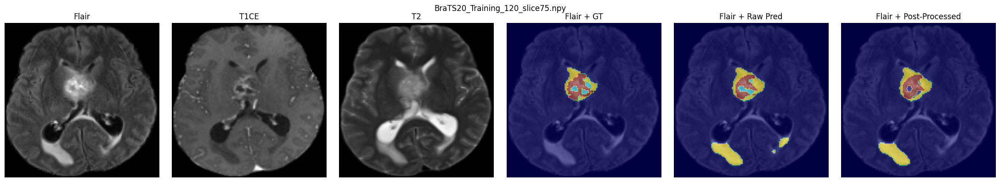

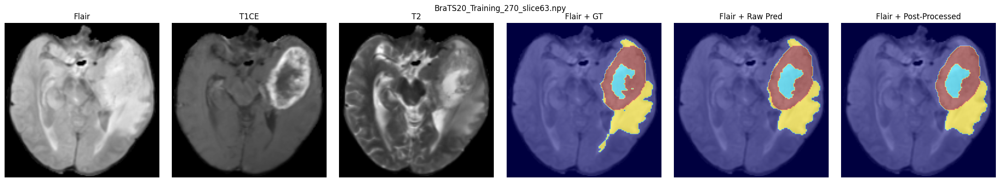

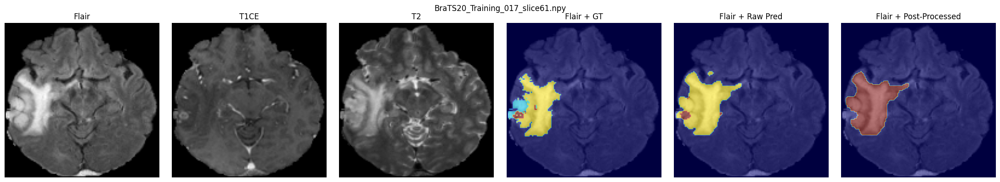

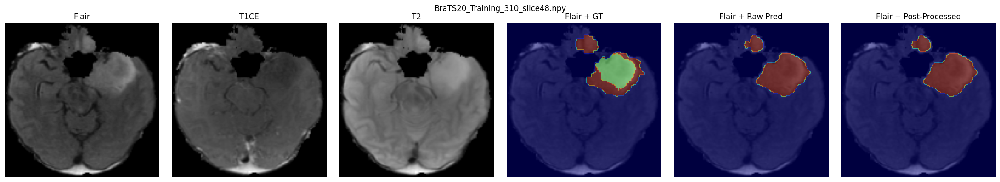

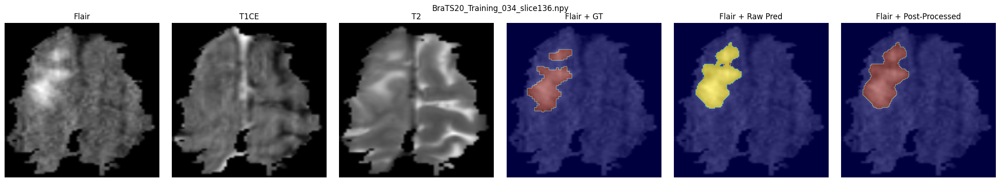

In [41]:
import cv2
def post_process_mask(predicted_mask, min_object_size=50):
    """
    Post-process the predicted mask:
    - Remove small connected components.
    - Apply morphological closing to fill holes.
    
    Args:
        predicted_mask: (H, W) Predicted mask (argmax or binary mask).
        min_object_size: Minimum size of connected components to retain.

    Returns:
        post_processed_mask: Post-processed mask.
    """
    # Remove small connected components
    num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(predicted_mask.astype(np.uint8), connectivity=8)
    post_processed_mask = np.zeros_like(predicted_mask, dtype=np.uint8)

    for i in range(1, num_labels):  # Ignore the background (label 0)
        if stats[i, cv2.CC_STAT_AREA] >= min_object_size:
            post_processed_mask[labels == i] = 1

    # Morphological closing (fill small holes)
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    post_processed_mask = cv2.morphologyEx(post_processed_mask, cv2.MORPH_CLOSE, kernel)

    return post_processed_mask
def visualize_predictions_before_after_post(
    model,
    images_dir,
    masks_dir,
    patient_files,
    num_patients=3,
    slice_offset=0,
    min_object_size=50
):
    """
    Visualize raw and post-processed predictions side by side.
    For each slice, we display 7 columns in one row:
      1) Flair
      2) T1
      3) T1CE
      4) T2
      5) Flair + Ground Truth
      6) Flair + Raw Prediction
      7) Flair + Post-Processed Prediction
    
    Args:
        model: Trained segmentation model.
        images_dir: Path where preprocessed .npy images are stored.
        masks_dir: Path where preprocessed .npy masks are stored.
        patient_files: List of slice filenames, e.g. ["BraTS20_Training_123_slice10.npy", ...].
        num_patients: How many random patients to visualize.
        slice_offset: How many slices before/after the middle slice to pick.
        min_object_size: Minimum area for connected components in post-processing.
    """
    import random

    # Unique patient IDs
    patient_ids = list(set(fname.split('_slice')[0] for fname in patient_files))
    random.shuffle(patient_ids)

    # We'll only visualize 'num_patients'
    for pid in patient_ids[:num_patients]:
        # Gather all slice filenames for this patient
        slices_for_patient = sorted([f for f in patient_files if f.startswith(pid)])

        # Pick slices around the middle
        mid_idx = len(slices_for_patient) // 2
        selected_slices = slices_for_patient[
            max(0, mid_idx - slice_offset) : min(len(slices_for_patient), mid_idx + slice_offset + 1)
        ]

        for slice_fname in selected_slices:
            # Load the preprocessed image & mask
            img_path  = os.path.join(images_dir, slice_fname)
            mask_path = os.path.join(masks_dir,  slice_fname)

            img_4ch   = np.load(img_path)   # shape (H, W, 4)
            mask_1hot = np.load(mask_path)  # shape (H, W, 4)
            gt_label  = np.argmax(mask_1hot, axis=-1)  # ground truth

            # Get raw prediction
            pred_soft  = model.predict(img_4ch[None,...], verbose=0)[0]  # shape (H, W, 4)
            pred_label = np.argmax(pred_soft, axis=-1)

            # Post-process each class (skip background=0)
            post_label = np.zeros_like(pred_label, dtype=np.uint8)
            for c in range(1, pred_soft.shape[-1]):
                class_mask = (pred_label == c).astype(np.uint8)
                post_mask  = post_process_mask(class_mask, min_object_size=min_object_size)
                post_label[post_mask == 1] = c

            # Now visualize
            plt.figure(figsize=(22, 4))
            # Indices for subplots in one row (7 columns)
            # 1) Flair
            plt.subplot(1,6,1)
            plt.imshow(np.rot90(img_4ch[...,0], k=3), cmap='gray')
            plt.title("Flair")
            plt.axis('off')

        
            # 3) T1CE
            plt.subplot(1,6,2)
            plt.imshow(np.rot90(img_4ch[...,2], k=3), cmap='gray')
            plt.title("T1CE")
            plt.axis('off')

            # 4) T2
            plt.subplot(1,6,3)
            plt.imshow(np.rot90(img_4ch[...,3], k=3), cmap='gray')
            plt.title("T2")
            plt.axis('off')

            # 5) Flair + Ground Truth
            plt.subplot(1,6,4)
            plt.imshow(np.rot90(img_4ch[...,0], k=3), cmap='gray')
            plt.imshow(np.rot90(gt_label, k=3), cmap='jet', alpha=0.5)
            plt.title("Flair + GT")
            plt.axis('off')

            # 6) Flair + Raw Pred
            plt.subplot(1,6,5)
            plt.imshow(np.rot90(img_4ch[...,0], k=3), cmap='gray')
            plt.imshow(np.rot90(pred_label, k=3), cmap='jet', alpha=0.5)
            plt.title("Flair + Raw Pred")
            plt.axis('off')

            # 7) Flair + Post-Proc Pred
            plt.subplot(1,6,6)
            plt.imshow(np.rot90(img_4ch[...,0], k=3), cmap='gray')
            plt.imshow(np.rot90(post_label, k=3), cmap='jet', alpha=0.5)
            plt.title("Flair + Post-Processed")
            plt.axis('off')

            plt.suptitle(f"{slice_fname}", fontsize=12)
            plt.tight_layout()
            plt.show()
visualize_predictions_before_after_post(
    model=history.model,
    images_dir=os.path.join(SAVE_DIR, "images"),
    masks_dir=os.path.join(SAVE_DIR, "masks"),
    patient_files=val_files,  # or train_files
    num_patients=5,          # how many random patients to show
    slice_offset=0,          # how many slices around middle
    min_object_size=100       # or your chosen threshold
)

In [42]:
def evaluate_with_postprocessing_full(model, val_gen, min_object_size=50):
    dice_before_list = []
    dice_after_list  = []

    # Evaluate over all batches
    num_batches = len(val_gen)
    for idx in range(num_batches):
        Xb, Yb = val_gen[idx]
        Y_pred_soft = model.predict(Xb, verbose=0)
        Y_pred = np.argmax(Y_pred_soft, axis=-1)
        Y_true = np.argmax(Yb, axis=-1)

        for i in range(len(Xb)):
            # One-hot for dice_coefficient
            Y_true_1hot = tf.one_hot(Y_true[i], depth=Yb.shape[-1])
            Y_pred_1hot = tf.one_hot(Y_pred[i], depth=Yb.shape[-1])

            # Dice before
            dice_b = dice_coefficient(Y_true_1hot, Y_pred_1hot).numpy()
            dice_before_list.append(dice_b)

            # Post-process each class
            Y_pred_post = np.zeros_like(Y_pred[i])
            for c in range(1, Yb.shape[-1]):  # skip background
                class_mask = (Y_pred[i] == c).astype(np.uint8)
                class_mask_post = post_process_mask(class_mask, min_object_size=min_object_size)
                Y_pred_post[class_mask_post == 1] = c

            Y_pred_post_1hot = tf.one_hot(Y_pred_post, depth=Yb.shape[-1])

            # Dice after
            dice_a = dice_coefficient(Y_true_1hot, Y_pred_post_1hot).numpy()
            dice_after_list.append(dice_a)

    return np.mean(dice_before_list), np.mean(dice_after_list)

In [43]:
dice_before, dice_after = evaluate_with_postprocessing_full(model, val_gen, min_object_size=50)
print(f"Dice Before Post-Processing: {dice_before:.4f}")
print(f"Dice After  Post-Processing: {dice_after:.4f}")

Dice Before Post-Processing: 0.9771
Dice After  Post-Processing: 0.9763


In [44]:
# Identify which layer is your first conv layer
# E.g. unet_conv_block is composed of two conv layers. We can pick the very first conv.
first_conv_layer = None
for layer in model.layers:
    if isinstance(layer, tf.keras.layers.Conv2D):
        first_conv_layer = layer
        break

if first_conv_layer is None:
    print("No Conv2D layer found!")
else:
    print("First convolutional layer:", first_conv_layer.name)

First convolutional layer: conv2d


In [45]:
filters, biases = first_conv_layer.get_weights()
# shape of 'filters' is (kernel_height, kernel_width, in_channels, out_channels)
print("Filters shape:", filters.shape)
print("Bias shape:", biases.shape)

Filters shape: (3, 3, 4, 64)
Bias shape: (64,)


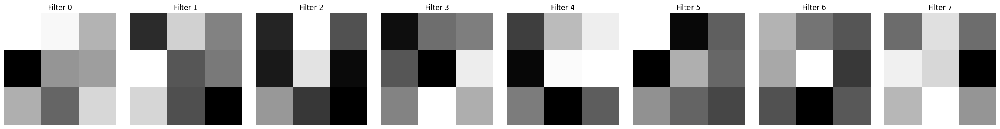

In [46]:
import math

def visualize_first_layer_filters(model, channel=0, max_filters=8):
    # Find the first Conv2D layer
    first_conv_layer = None
    for layer in model.layers:
        if isinstance(layer, tf.keras.layers.Conv2D):
            first_conv_layer = layer
            break
    
    if first_conv_layer is None:
        print("No Conv2D layer found!")
        return
    
    filters, biases = first_conv_layer.get_weights()
    # filters shape: (kernel_height, kernel_width, in_channels, out_channels)
    k_height, k_width, in_ch, out_ch = filters.shape
    
    # We'll only visualize up to 'max_filters' to keep the plot manageable
    n_filters = min(out_ch, max_filters)
    
    # Create a grid
    cols = n_filters
    fig, axes = plt.subplots(nrows=1, ncols=cols, figsize=(3*cols, 3))
    
    for i in range(n_filters):
        # Extract the filter for the 'i'-th output channel, but specifically the requested 'channel' input
        f_image = filters[..., channel, i]
        # Normalize to 0..1 for better visualization
        f_min, f_max = np.min(f_image), np.max(f_image)
        if f_max - f_min < 1e-5:
            # Avoid divide-by-zero if the filter is constant
            f_image_norm = f_image
        else:
            f_image_norm = (f_image - f_min) / (f_max - f_min)
        
        axes[i].imshow(f_image_norm, cmap='gray')
        axes[i].set_title(f"Filter {i}")
        axes[i].axis('off')
    
    plt.tight_layout()
    plt.show()

# Example usage:
visualize_first_layer_filters(model, channel=0, max_filters=8)

In [47]:
# Identify the layer names (or outputs) you want to visualize
layer_names = []
for layer in model.layers:
    # Possibly pick only certain blocks
    if isinstance(layer, tf.keras.layers.Conv2D):
        layer_names.append(layer.name)

# Build a model that returns outputs at each of these layers
intermediate_outputs = [model.get_layer(name).output for name in layer_names]
activation_model = tf.keras.Model(inputs=model.input, outputs=intermediate_outputs)

In [48]:
sample_fname = train_files[100]
img_4ch = np.load(os.path.join(SAVE_DIR, "images", sample_fname))
img_input = img_4ch[None, ...]  # shape (1,H,W,4)


feature_maps = activation_model.predict(img_input)

I0000 00:00:1765728246.543324      98 service.cc:148] XLA service 0x784da4051eb0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1765728246.544972      98 service.cc:156]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


I0000 00:00:1765728249.108107      98 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


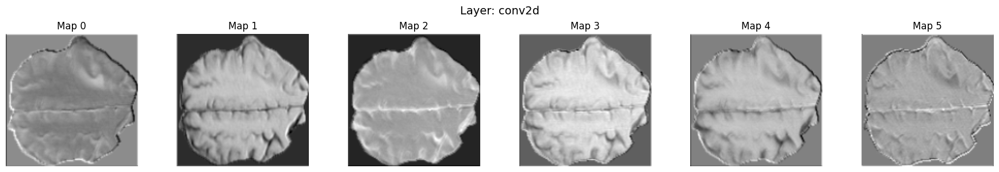

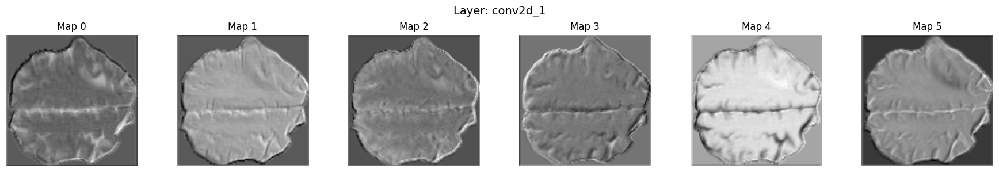

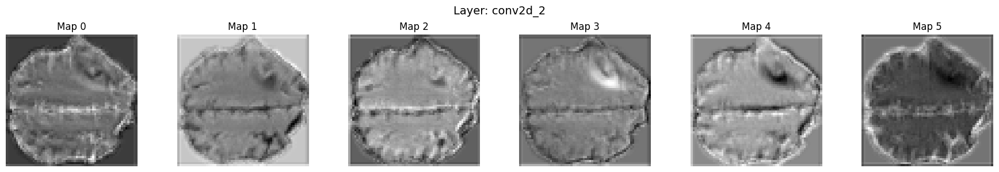

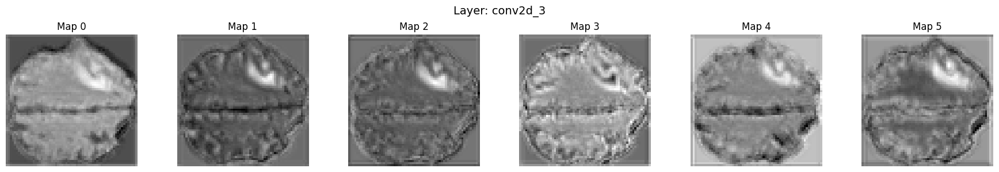

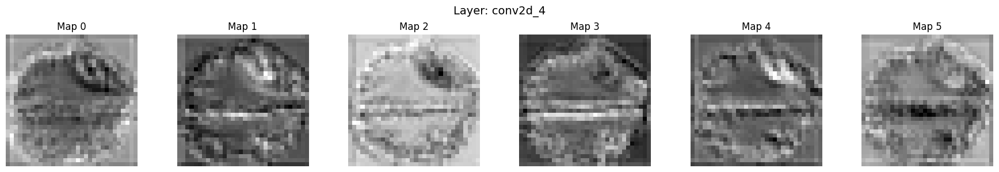

...

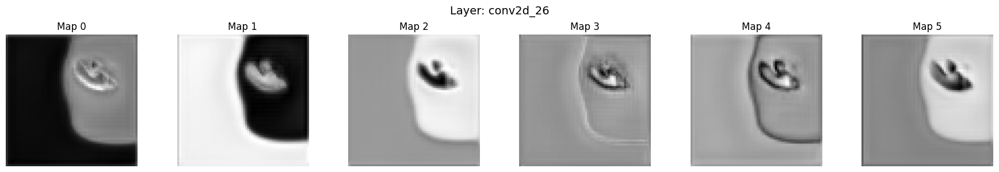

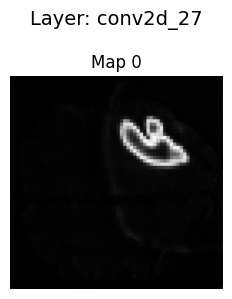

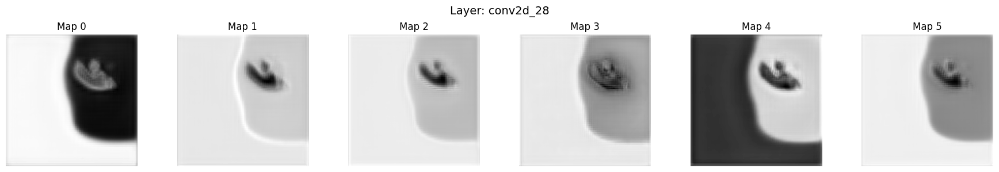

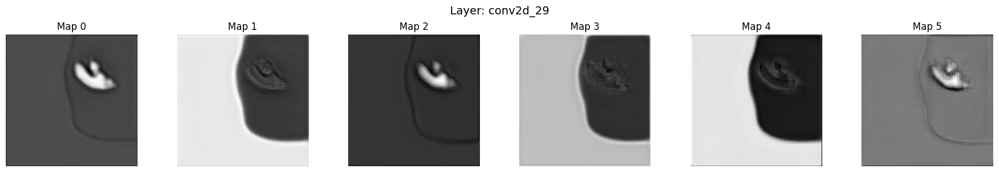

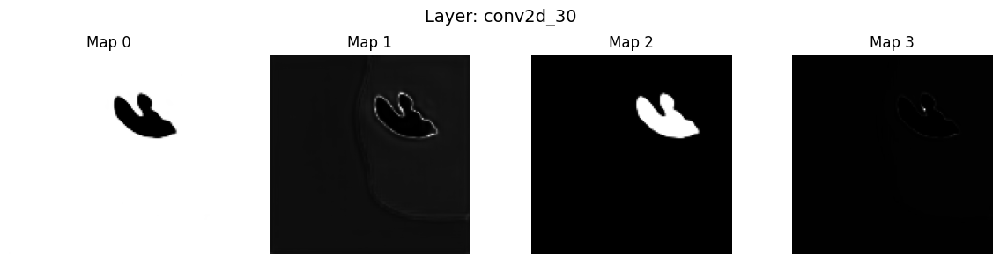

In [49]:
def visualize_activation_maps(feature_maps, layer_names, max_maps=6):
    """
    Show up to 'max_maps' channels from each layer's feature map
    """
    for layer_name, fm in zip(layer_names, feature_maps):
        # fm shape: (1, H', W', C')
        fm = fm[0]  # remove batch dimension
        h, w, c = fm.shape
        n_maps = min(c, max_maps)
        
        # Create subplots
        fig, axes = plt.subplots(nrows=1, ncols=n_maps, figsize=(3*n_maps, 3))
        fig.suptitle(f"Layer: {layer_name}", fontsize=14)
        
        # Handle the case where axes is not a list
        if n_maps == 1:
            axes = [axes]
        
        for i in range(n_maps):
            ax = axes[i]
            fm_map = fm[..., i]
            # Normalize for display
            f_min, f_max = np.min(fm_map), np.max(fm_map)
            if f_max - f_min < 1e-5:
                fm_map_norm = fm_map
            else:
                fm_map_norm = (fm_map - f_min) / (f_max - f_min)
            ax.imshow(fm_map_norm, cmap='gray')
            ax.set_title(f"Map {i}")
            ax.axis('off')
        
        plt.tight_layout()
        plt.show()

# Example usage
visualize_activation_maps(feature_maps, layer_names, max_maps=6)

**Survival Info**

In [50]:
!pip install -U --quiet scikit-learn imbalanced-learn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.1/9.1 MB 59.3 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 240.0/240.0 kB 13.5 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
category-encoders 2.7.0 requires scikit-learn<1.6.0,>=1.0.0, but you have scikit-learn 1.8.0 which is incompatible.
cesium 0.12.4 requires numpy<3.0,>=2.0, but you have numpy 1.26.4 which is incompatible.
sklearn-compat 0.1.3 requires scikit-learn<1.7,>=1.2, but you have scikit-learn 1.8.0 which is incompatible.


In [51]:
import xgboost as xgb
import lightgbm as lgb
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.preprocessing import LabelEncoder
#from imblearn.over_sampling import SMOTE
import glob


ImportError: cannot import name '_fit_context' from 'sklearn.base' (/usr/local/lib/python3.11/dist-packages/sklearn/base.py)

In [ ]:
# Paths to CSVs (adjust if needed)
NAME_MAPPING_CSV = "/kaggle/input/brain-tumor-segmentation-in-mri-brats-2015/MICCAI_BraTS2020_TrainingData/name_mapping.csv"
SURVIVAL_INFO_CSV = "/kaggle/input/brain-tumor-segmentation-in-mri-brats-2015/MICCAI_BraTS2020_TrainingData/survival_info.csv"

# Load CSVs
mapping_df = pd.read_csv(NAME_MAPPING_CSV)
survival_df = pd.read_csv(SURVIVAL_INFO_CSV)

# Keep the relevant columns
# We'll rename BraTS_2020_subject_ID -> Brats20ID for consistency
mapping_df = mapping_df[["BraTS_2020_subject_ID", "Grade"]].rename(
    columns={"BraTS_2020_subject_ID": "Brats20ID"}
)

# Merge on Brats20ID
merged_df = pd.merge(mapping_df, survival_df, on="Brats20ID", how="inner")

print("Merged dataframe shape:", merged_df.shape)
print(merged_df.head(5))

In [ ]:
# Convert Survival_days to numeric (in case they are strings)
merged_df["Survival_days"] = pd.to_numeric(merged_df["Survival_days"], errors="coerce")

# Drop rows that have NaN in Survival_days
merged_df.dropna(subset=["Survival_days"], inplace=True)

def short_long_label(days):
    # 365 days = ~12 months
    if days < 365:
        return "Short"
    else:
        return "Long"

merged_df["Survival_Class"] = merged_df["Survival_days"].apply(short_long_label)

print("\nDistribution of Short vs. Long:")
print(merged_df["Survival_Class"].value_counts())

In [ ]:
PREPROCESSED_MASK_DIR = "/kaggle/temp/preprocessed_data/masks"

def compute_tumor_features(patient_id, mask_dir=PREPROCESSED_MASK_DIR):
    """
    Aggregates all slices for `patient_id` in `mask_dir`.
    Returns a dict with sub-region volumes & total tumor volume.
    """
    slice_files = glob.glob(os.path.join(mask_dir, f"{patient_id}_slice*.npy"))
    
    necrotic_count = 0
    edema_count = 0
    enhancing_count = 0
    
    for f in slice_files:
        mask_3d = np.load(f)  # shape (H, W, 4)
        # Convert one-hot to label
        label_2d = np.argmax(mask_3d, axis=-1)
        
        necrotic_count   += np.count_nonzero(label_2d == 1)
        edema_count      += np.count_nonzero(label_2d == 2)
        enhancing_count  += np.count_nonzero(label_2d == 3)
        
    total_tumor = necrotic_count + edema_count + enhancing_count
    
    return {
        "necrotic_vol": necrotic_count,
        "edema_vol": edema_count,
        "enhancing_vol": enhancing_count,
        "total_tumor_vol": total_tumor
    }

In [ ]:
feature_rows = []
for pid in merged_df["Brats20ID"]:
    feats = compute_tumor_features(pid, PREPROCESSED_MASK_DIR)
    row = {"Brats20ID": pid}
    row.update(feats)
    feature_rows.append(row)

tumor_df = pd.DataFrame(feature_rows)
print("\nTumor features (first few rows):")
print(tumor_df.head())

In [ ]:
full_df = pd.merge(merged_df, tumor_df, on="Brats20ID", how="left")
print("\nFull dataset shape:", full_df.shape)
print(full_df.head())

In [ ]:
# Suppose we want to use 'Age', 'necrotic_vol', 'edema_vol', 'enhancing_vol', 'total_tumor_vol' as features
needed_cols = ["Age", "necrotic_vol", "edema_vol", "enhancing_vol", "total_tumor_vol", "Survival_Class"]
full_df = full_df.dropna(subset=needed_cols)

# Create a numeric label for short/long
def binary_label(cls):
    # cls is 'Short' or 'Long'
    return 0 if cls=="Short" else 1

full_df["Binary_Class"] = full_df["Survival_Class"].apply(binary_label)

print("\nFinal distribution of (Short=0, Long=1):")
print(full_df["Binary_Class"].value_counts())

In [ ]:
from sklearn.model_selection import train_test_split

X = full_df[["Age", "necrotic_vol", "edema_vol", "enhancing_vol", "total_tumor_vol"]]
y = full_df["Binary_Class"]

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)
print("\nTrain size:", X_train.shape, "Val size:", X_val.shape)

# Optionally balance classes via SMOTE
#smote = SMOTE(random_state=42)
#X_train_res, y_train_res = smote.fit_resample(X_train, y_train)

#print("After SMOTE resampling, training set size:", X_train_res.shape)

In [ ]:

model = xgboost_model = xgb.XGBClassifier(
    n_estimators= 100,
    max_depth=5,
    learning_rate=0.01,
    random_state=42
)

xgboost_model.fit(X_train, y_train)

y_pred = xgboost_model.predict(X_val)

In [ ]:
print("\nConfusion Matrix:")
print(confusion_matrix(y_val, y_pred))  # shape: 2x2

print("\nClassification Report:")
print(classification_report(y_val, y_pred, target_names=["Short", "Long"]))

In [ ]:
from sklearn.model_selection import GridSearchCV

param_grid = {
  'n_estimators': [ 100],
  'max_depth': [3, 4, 5],
  'learning_rate': [0.001, 0.01, 0.05],
  'subsample': [0.8, 1.0],
  'colsample_bytree': [0.8, 1.0]


}

grid_model = xgb.XGBClassifier(random_state=42)
grid_search = GridSearchCV(
    grid_model, 
    param_grid, 
    scoring="accuracy", 
    cv=5, 
    verbose=1,
    n_jobs=-1
)

grid_search.fit(X_train, y_train)
best_model = grid_search.best_estimator_
print("Best params:", grid_search.best_params_)

# Evaluate best_model
y_pred_best = best_model.predict(X_val)
print("\nGridSearch - Classification Report:")
print(classification_report(y_val, y_pred_best, target_names=["Short", "Long"]))

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

def plot_confusion_matrix(model, X_val, y_val, class_names=None, title="Confusion Matrix"):
    """
    Plots a confusion matrix using Seaborn's heatmap.
    Assumes a binary classifier with labels 0 & 1.
    `class_names` could be ["Short", "Long"] for example.
    """
    y_pred = model.predict(X_val)
    cm = confusion_matrix(y_val, y_pred)

    plt.figure(figsize=(6,4),dpi=1000)
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
                xticklabels=class_names, yticklabels=class_names)
    plt.title(title)
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.show()

# Example usage:
plot_confusion_matrix(
    best_model, 
    X_val, 
    y_val, 
    class_names=["Short", "Long"],
    title="XGBoost Confusion Matrix"
)

In [ ]:
xgb.plot_importance(best_model, height=0.5)
plt.title("Feature Importance (XGBoost)")
plt.show()